# **Rock-Paper-Scissor Competition (40%)**
For this competition, we will use the Game (https://cloudstor.aarnet.edu.au/plus/s/6QNijohkrfMZ0H7) dataset. This dataset contains images of hand gestures from the Rock-Paper-Scissors game. 

The dataset contains a total of 2188 images corresponding to the 'Rock' (726 images), 'Paper' (710 images) and 'Scissors' (752 images) hand gestures of the Rock-Paper-Scissors game. All image are taken on a green background with relatively consistent ligithing and white balance.

All images are RGB images of 300 pixels wide by 200 pixels high in .png format. The images are separated in three sub-folders named 'rock', 'paper' and 'scissors' according to their respective class.

The task is to categorize each hand guesters into one of three categories (Rock/Paper/Scissor). 

We provide a baseline by the following steps:


*   Loding and Analysing the dataset using torchvision.
*   Defining a simple convolutional neural network. 
*   How to use existing loss function for the model learning. 
*   Train the network on the training data. 
*   Test the trained network on the testing data. 

The following trick/tweak(s) could be considered:
-------
1. Change of advanced training parameters: Learning Rate, Optimizer, Batch-size, Number of Max Epochs, and Drop-out. 
2. Use of a new loss function.
3. Data augmentation
4. Architectural Changes: Batch Normalization, Residual layers, Attention Block, and other varients.

Your code should be modified from the provided baseline. A pdf report is required to explain the tricks you employed, and the imporvements they achieved.
Marking Rules:
-------
We will mark the competition based on the final test accuracy on testing images and your report.

Final mark = acc_mark + efficiency mark + report mark + bonus mark
###Acc_mark 15:

We will rank all the submission results based on their test accuracy. The top 30% of the students will get full marks.


|Accuracy|Mark|
|---|---|
| Top 30% in the class|          15|
|30%-50%|         11|
|50%-80%  |        7|
| 80%-90%  |      3|
| 90%-100%  |      1|
|Not implemented| 0|

###Efficiency mark 5:

Efficiency is evaluated by the computational costs (flops: https://en.wikipedia.org/wiki/FLOPS). Please report the computational costs for your final model and attach the code/process about how you calculate it.

|Efficiency|Mark|
|---|---|
| Top 30% in the class|          5|
|30%-50%|         4|
|50%-80%  |        3|
| 80%-90%  |      2|
| 90%-100%  |      2|
|Not implemented| 0|

###Report mark 20:
1. Introduction and your understanding to the baseline model: 2 points

2. Employed more than three tricks with ablation studies to improve the accuracy: 6 points

Clearly explain the reference, motivation and design choice for each trick/tweak(s). Providing the experimental results in tables.
Example table:

|Trick1|Trick2|Trick3|Accuracy|
|---|---|---|---|
|N|N|N|89.2%|
|Y|N|N|97.55%|
|Y|Y|N|77%|
|Y|Y|Y|82%|

Observation and discussion based on the experiment results.

3. Expaination of the methods on reducing the computational cost and/or improve the trade-off between accuracy and efficiency: 4 points

4. Explaination of the code implementation：3 points

5. Visulization results: e.g. training and testing accuracy/loss for each model, case studies: 3 points

6. Open ended:  Limitations, conclusions, failure cases analysis...: 2 points

###Bouns mark:
1. Top three results: 2 points
2. Fancy designs: 2 points

In [1]:
##################################################################################################################################
### Subject: Computer Vision 
### Year: 2022
### Student Name: peiyan Chen, siyu Huang
### Student ID: a1788396, a1810323
### Comptetion Name: Rock-Paper-Scissor Classification Competition
### Final Results:
### ACC: 100%        FLOPs: 0.29G
##################################################################################################################################

In [82]:
import tensorflow as tf
import tensorflow_datasets as tfds
import platform
import math

import os
import random
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from tqdm.notebook import tqdm
import warnings
warnings.filterwarnings('ignore')
from torchvision import datasets, transforms, models 
from torchvision.datasets import ImageFolder
from torchvision.transforms import ToTensor
from torchvision.utils import make_grid
from torch.utils.data import random_split
from torch.utils.data.dataloader import DataLoader
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

In [83]:
# Load the TensorBoard notebook extension.
# %reload_ext tensorboard
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [84]:
# Clear any logs from previous runs.
!rm -rf ./logs/

In [85]:
!unzip /content/drive/MyDrive/competition/dataset-20220625T103904Z-001.zip

Archive:  /content/drive/MyDrive/competition/dataset-20220625T103904Z-001.zip
replace dataset/rock/xBWG6t5EvReNN7mW.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [86]:
from google.colab import drive
drive.mount('/content/drive')

data_dir = '/content/dataset'
classes = os.listdir(data_dir)
print(len(classes))

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
3


In [123]:
# Performing Image Transformations.
##Hints: Data Augmentation can be applied here. Have a look on RandomFlip, RandomRotation... 
train_transform=transforms.Compose([
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.Grayscale(num_output_channels=3),
        transforms.RandomRotation(20),                                    
        transforms.Resize(20),             # resize shortest side Hints: larger input size can lead to higher performance
        transforms.CenterCrop(20),         # crop longest side Hints: crop size is usuallt smaller than the resize size
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406],
                             [0.229, 0.224, 0.225]),
        transforms.RandomErasing()
])

In [88]:
dataset = ImageFolder(data_dir, transform=train_transform)

In [89]:
# Setting seed so that value won't change everytime. 
# Splitting the dataset to training, validation, and testing category.
torch.manual_seed(10)
val_size = len(dataset)//10
test_size = len(dataset)//5
train_size = len(dataset) - val_size - test_size

val_size, test_size, train_size

(218, 437, 1533)

In [90]:
# Random Splitting. 
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size])
len(train_ds), len(val_ds),len(test_ds)  

(1533, 218, 437)

In [91]:
batch_size = 64
train_loader = DataLoader(train_ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size*2, num_workers=2, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size*2, num_workers=2, pin_memory=True)

------------------------------------------------------------------------------

In [92]:
# Baseline model class for training and validation purpose. Evaluation metric function - Accuracy.

def accuracy(outputs, labels):
    _, preds = torch.max(outputs, dim=1)
    return torch.tensor(torch.sum(preds == labels).item() / len(preds))

class ImageClassificationBase(nn.Module):
    def training_step(self, batch):
        images, labels = batch 
        out = self(images)                  # Generate predictions
        loss = F.cross_entropy(out, labels) # Calculate loss
        #loss = F.mse_loss(out, labels)
        #loss = F.binary_cross_entropy_with_logits(out, labels)
        #loss = F.huber_loss(out, labels)
        train_acc = accuracy(out, labels)

        return loss, train_acc
    
    def validation_step(self, batch):
        images, labels = batch 
        out = self(images)                    # Generate predictions
        loss = F.cross_entropy(out, labels)   # Calculate loss
        #loss = F.mse_loss(out, labels)
        #loss = F.binary_cross_entropy_with_logits(out, labels)
        #loss = F.huber_loss(out, labels)
        acc = accuracy(out, labels)           # Calculate accuracy
        return {'val_loss': loss.detach(), 'val_acc': acc}
        
    def validation_epoch_end(self, outputs):
        batch_losses = [x['val_loss'] for x in outputs]
        epoch_loss = torch.stack(batch_losses).mean()   # Combine losses
        batch_accs = [x['val_acc'] for x in outputs]
        epoch_acc = torch.stack(batch_accs).mean()      # Combine accuracies
        return {'val_loss': epoch_loss.item(), 'val_acc': epoch_acc.item()}
    
    def epoch_end(self, epoch, result):
        print("Epoch [{}], train_loss: {:.4f}, val_loss: {:.4f}, train_acc: {:.4f}, val_acc: {:.4f}".format(
            epoch, result['train_loss'], result['val_loss'], result['train_acc'],result['val_acc']))

In [93]:
# Functions for evaluation and training.
def evaluate(model, val_loader):
    outputs = [model.validation_step(batch) for batch in val_loader]
    return model.validation_epoch_end(outputs)

def fit(epochs, lr, model, train_loader, val_loader, opt_func=torch.optim.SGD):
    history = []
    optimizer = opt_func(model.parameters(), lr)
    for epoch in range(epochs):
        # Training Phase 
        model.train()
        train_losses = []
        train_accuracies = []
        for batch in tqdm(train_loader):
            loss, acc = model.training_step(batch)
            train_losses.append(loss)
            train_accuracies.append(acc)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
        # Validation phase
        result = evaluate(model, val_loader)
        result['train_loss'] = torch.stack(train_losses).mean().item()
        result['train_acc'] = torch.stack(train_accuracies).mean().item()
        model.epoch_end(epoch, result)
        history.append(result)
    return history

In [95]:
# To check wether Google Colab GPU has been assigned/not. 

def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return None
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)



In [96]:
device = get_default_device()
device
train_loader = DeviceDataLoader(train_loader, device)
val_loader = DeviceDataLoader(val_loader, device)
test_loader = DeviceDataLoader(test_loader, device)

In [97]:
input_size = 3*40*40
output_size = 3

In [124]:
class CnnModel(ImageClassificationBase):
    def __init__(self, classes):
        super().__init__()
        self.classes = classes
        self.network = nn.Sequential(
            nn.Conv2d(3, 100, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(100, 150, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2), 

            nn.Conv2d(150, 200, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Conv2d(200, 200, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2), 

            nn.Conv2d(200, 250, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.Conv2d(250, 250, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2), 

            nn.Flatten(), 
            nn.Linear(1000, 64),  
            nn.ReLU(),            
            nn.Linear(64, 32),  
            nn.ReLU(),            
            nn.Linear(32, 16),           
            nn.ReLU(),
            nn.Linear(16, 8),
            nn.ReLU(),
            nn.Dropout(0.25),
            nn.Linear(8, self.classes))
        
    def forward(self, xb):
        return self.network(xb)

In [128]:
# Model print
num_classes = 3
model = CnnModel(num_classes)
model.cuda()

CnnModel(
  (network): Sequential(
    (0): Conv2d(3, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(100, 150, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(150, 200, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU()
    (7): Conv2d(200, 200, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU()
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(200, 250, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU()
    (12): Conv2d(250, 250, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU()
    (14): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (15): Flatten(start_dim=1, end_dim=-1)
    (16): Linear(in_features=1000, out_features=64, bias=True)
    (17): ReLU()
    (18): Linear(in_features=

In [129]:
train_dl = DeviceDataLoader(train_loader, device)
val_dl = DeviceDataLoader(val_loader, device)
to_device(model, device)

CnnModel(
  (network): Sequential(
    (0): Conv2d(3, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(100, 150, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(150, 200, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU()
    (7): Conv2d(200, 200, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU()
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(200, 250, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU()
    (12): Conv2d(250, 250, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU()
    (14): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (15): Flatten(start_dim=1, end_dim=-1)
    (16): Linear(in_features=1000, out_features=64, bias=True)
    (17): ReLU()
    (18): Linear(in_features=

In [101]:
@torch.no_grad()
def evaluate(model, val_loader):
    model.eval()
    outputs = [model.validation_step(batch) for batch in val_loader]
    return model.validation_epoch_end(outputs)

def fit(epochs, lr, model, train_loader, val_loader, opt_func=torch.optim.Adam):
    history = []
    optimizer = opt_func(model.parameters(), lr)
    for epoch in range(epochs):
        # Training Phase 
        model.train()
        train_losses = []
        train_accuracies = []
        for batch in tqdm(train_loader):
            loss, acc = model.training_step(batch)
            train_losses.append(loss)
            train_accuracies.append(acc)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
        # Validation phase
        result = evaluate(model, val_loader)
        result['train_loss'] = torch.stack(train_losses).mean().item()
        result['train_acc'] = torch.stack(train_accuracies).mean().item()
        model.epoch_end(epoch, result)
        history.append(result)
    return history

In [110]:
model = to_device(CnnModel(3), device)

In [111]:
history=[]

In [112]:
num_epochs = 82
opt_func = torch.optim.Adam
lr = 0.001

The following is the training and testing log of the final model:

In [122]:
history+= fit(num_epochs, lr, model, train_dl, val_dl, opt_func)

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1184, val_loss: 1.1011, train_acc: 0.3228, val_acc: 0.3542


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.1123, val_loss: 1.0786, train_acc: 0.3280, val_acc: 0.4410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 1.0464, val_loss: 0.9025, train_acc: 0.3977, val_acc: 0.5641


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.7534, val_loss: 0.6323, train_acc: 0.6414, val_acc: 0.7122


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.5434, val_loss: 0.3800, train_acc: 0.7751, val_acc: 0.8468


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.3998, val_loss: 0.3740, train_acc: 0.8487, val_acc: 0.8680


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.3625, val_loss: 0.3487, train_acc: 0.8664, val_acc: 0.8747


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.3599, val_loss: 0.2713, train_acc: 0.8635, val_acc: 0.9159


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.2774, val_loss: 0.2129, train_acc: 0.8904, val_acc: 0.9365


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2241, val_loss: 0.2396, train_acc: 0.9125, val_acc: 0.9410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.1871, val_loss: 0.2491, train_acc: 0.9100, val_acc: 0.9126


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.2225, val_loss: 0.1782, train_acc: 0.9119, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1791, val_loss: 0.1184, train_acc: 0.9185, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1575, val_loss: 0.1595, train_acc: 0.9303, val_acc: 0.9455


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1786, val_loss: 0.2482, train_acc: 0.9347, val_acc: 0.9387


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.2194, val_loss: 0.1388, train_acc: 0.9074, val_acc: 0.9549


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1838, val_loss: 0.1938, train_acc: 0.9203, val_acc: 0.9410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1659, val_loss: 0.1687, train_acc: 0.9309, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.1527, val_loss: 0.1957, train_acc: 0.9433, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1491, val_loss: 0.1000, train_acc: 0.9446, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1488, val_loss: 0.1022, train_acc: 0.9393, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1315, val_loss: 0.1596, train_acc: 0.9484, val_acc: 0.9488


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1281, val_loss: 0.1329, train_acc: 0.9491, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1117, val_loss: 0.1324, train_acc: 0.9511, val_acc: 0.9549


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.1275, val_loss: 0.1725, train_acc: 0.9510, val_acc: 0.9510


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.2252, val_loss: 0.1205, train_acc: 0.9126, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1691, val_loss: 0.0831, train_acc: 0.9386, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1264, val_loss: 0.0791, train_acc: 0.9459, val_acc: 0.9766


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1209, val_loss: 0.1105, train_acc: 0.9457, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1020, val_loss: 0.1177, train_acc: 0.9583, val_acc: 0.9671


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.1130, val_loss: 0.0681, train_acc: 0.9544, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.0860, val_loss: 0.0406, train_acc: 0.9647, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.1357, val_loss: 0.0817, train_acc: 0.9517, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0954, val_loss: 0.1471, train_acc: 0.9570, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.1333, val_loss: 0.1011, train_acc: 0.9479, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1172, val_loss: 0.1244, train_acc: 0.9589, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.1073, val_loss: 0.1190, train_acc: 0.9556, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.1099, val_loss: 0.0646, train_acc: 0.9563, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.1006, val_loss: 0.1284, train_acc: 0.9577, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.1248, val_loss: 0.1158, train_acc: 0.9477, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.1155, val_loss: 0.1443, train_acc: 0.9563, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.1128, val_loss: 0.0897, train_acc: 0.9557, val_acc: 0.9722


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.1277, val_loss: 0.0704, train_acc: 0.9471, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.1024, val_loss: 0.0866, train_acc: 0.9615, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0924, val_loss: 0.0758, train_acc: 0.9609, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0957, val_loss: 0.0364, train_acc: 0.9629, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0907, val_loss: 0.1171, train_acc: 0.9627, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0917, val_loss: 0.1118, train_acc: 0.9582, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0893, val_loss: 0.0394, train_acc: 0.9615, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0839, val_loss: 0.0157, train_acc: 0.9655, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0901, val_loss: 0.0776, train_acc: 0.9590, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.1042, val_loss: 0.0834, train_acc: 0.9653, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.1130, val_loss: 0.0763, train_acc: 0.9497, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0771, val_loss: 0.0502, train_acc: 0.9641, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.1212, val_loss: 0.0658, train_acc: 0.9557, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0798, val_loss: 0.0431, train_acc: 0.9680, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0816, val_loss: 0.0404, train_acc: 0.9655, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.1034, val_loss: 0.1471, train_acc: 0.9635, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.1019, val_loss: 0.0394, train_acc: 0.9576, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0872, val_loss: 0.0719, train_acc: 0.9687, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0876, val_loss: 0.0570, train_acc: 0.9648, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0723, val_loss: 0.0322, train_acc: 0.9674, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.1021, val_loss: 0.0513, train_acc: 0.9544, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0779, val_loss: 0.0603, train_acc: 0.9647, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0725, val_loss: 0.0152, train_acc: 0.9642, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0526, val_loss: 0.0361, train_acc: 0.9785, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0738, val_loss: 0.0382, train_acc: 0.9693, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0759, val_loss: 0.1136, train_acc: 0.9641, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0629, val_loss: 0.1226, train_acc: 0.9687, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0631, val_loss: 0.0182, train_acc: 0.9687, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0714, val_loss: 0.1344, train_acc: 0.9700, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0675, val_loss: 0.0516, train_acc: 0.9726, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.1012, val_loss: 0.0884, train_acc: 0.9603, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.1237, val_loss: 0.0812, train_acc: 0.9531, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0799, val_loss: 0.0466, train_acc: 0.9589, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0993, val_loss: 0.0216, train_acc: 0.9654, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0820, val_loss: 0.0463, train_acc: 0.9654, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0782, val_loss: 0.1248, train_acc: 0.9693, val_acc: 0.9611


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0806, val_loss: 0.0157, train_acc: 0.9661, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0633, val_loss: 0.0567, train_acc: 0.9739, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0705, val_loss: 0.0468, train_acc: 0.9687, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0674, val_loss: 0.0123, train_acc: 0.9719, val_acc: 1.0000


In [127]:
from FLOPs_counter import print_model_parm_flops
input = torch.randn(1, 3, 20, 20) # The input size should be the same as the size that you put into your model 
#Get the network and its FLOPs
num_classes = 3
model = CnnModel(num_classes)
print_model_parm_flops(model, input, detail=False)

 + Number of FLOPs: 0.29G


In [130]:
print("-------------------------------------------------------------------------------------------------------------------------------------------")

-------------------------------------------------------------------------------------------------------------------------------------------


The following are the training and testing logs from the various experiments we conducted

In [ ]:
result = []

In [ ]:
num_epochs = 40
opt_func = torch.optim.Adam
#opt_func = torch.optim.Adam(model.parameters(),lr = 0.001)
#opt_func = torch.optim.RMSprop(model.parameters(), lr = 0.001, alpha = 0.99, eps = 1e-08,momentum = 0, centered = False)
#opt_func = torch.optim.Adadelta(model.parameters(), lr=0.001, rho=0.9, eps=1e-6, weight_decay=0)
#opt_func = torch.optim.ASGD(model.parameters(),lr = 0.001)
#opt_func = torch.optim.Adamax(model.parameters(),lr = 0.001)
#opt_func = torch.optim.SGD(model.parameters(), lr= 0.001, momentum=0.5)
#opt_func = torch.optim.RAdam(model.parameters(),lr = 0.001)
#opt_func = torch.optim.AdamW(model.parameters(),lr = 0.001)
lr = 0.001

In [ ]:
import seaborn as sns


def plot_accuracies(history):
    accuracies = [x['val_acc'] for x in history]
    plt.plot(accuracies, '-x')
    plt.xlabel('epoch')
    plt.ylabel('accuracy')
    plt.title('Accuracy vs. No. of epochs')
    plt.show()
    
def plot_losses(history):
    train_losses = [x.get('train_loss') for x in history]
    val_losses = [x['val_loss'] for x in history]
    plt.plot(train_losses, '-bx')
    plt.plot(val_losses, '-rx')
    plt.xlabel('epoch')
    plt.ylabel('loss')
    plt.legend(['Training', 'Validation'])
    plt.title('Loss vs. No. of epochs')
    plt.show()

def plot_1(history, string):
  sns.set(style='darkgrid')
  sns.set(font_scale=1.5)
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,8))
  fig.suptitle(f'Loss & Accuracy curve with {string}')

  train_acc = [x['train_acc'] for x in history]
  val_acc = [x['val_acc'] for x in history]
  ax1.plot(train_acc,'-bx')
  ax1.plot(val_acc,'-rx')
  ax1.legend(['Train','Valid'])
  ax1.set(xlabel='Epoch', ylabel='Accuracy')
  ax1.set_title('Accuracy vs. No. of epochs')
  
  train_losses = [x.get('train_loss') for x in history]
  val_losses = [x['val_loss'] for x in history]
  ax2.plot(train_losses,'-bx')
  ax2.plot(val_losses,'-rx')
  ax2.legend(['Train','Valid'])
  ax2.set(xlabel='Epoch', ylabel='Losses')
  ax2.set_title('Loss vs. No. of epochs')

def plot_LR(history, string):
  sns.set(style='darkgrid')
  sns.set(font_scale=1.5)
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,8))
  fig.suptitle(f'Loss & Accuracy curve with {string}')
  temp = []
  for i in range(len(history)):
    accuracies = [x['val_acc'] for x in history[i]]
    temp.append(accuracies)
    ax1.plot(temp[i],'-x')
  ax1.legend(['lr = 1','lr = 0.1','lr = 0.01','lr = 0.001','lr = 0.0001'],loc='upper right')
  ax1.set(xlabel='Epoch', ylabel='Accuracy')
  ax1.set_title('Accuracy vs. No. of epochs')
  
  temp2 = []
  for i in range (len(history)):
    train_losses = [x.get('train_loss') for x in history[i]]
    temp2.append(train_losses)
    ax2.plot(temp2[i],'-x')
  ax2.legend(['lr = 1','lr = 0.1','lr = 0.01','lr = 0.001','lr = 0.0001'],loc='upper right')
  ax2.set_ylim(0.05,2)
  ax2.set(xlabel='Epoch', ylabel='Losses')
  ax2.set_title('Loss vs. No. of epochs')

def plot_opt(history, string):
  sns.set(style='darkgrid')
  sns.set(font_scale=1.5)
  fig, [[ax1, ax2],[ax3, ax4]] = plt.subplots(2,2,figsize=(20,16))
  fig.suptitle(f'Loss & Accuracy curve with {string}')
  temp = []
  for i in range(len(history)):
    accuracies = [x['val_acc'] for x in history[i]]
    temp.append(accuracies)
    ax1.plot(temp[i],'-x')
  ax1.legend(['Adam','RMSprop','Adadelta','ASGD','Adamax','SGD','RAdam','AdamW','NAdam'],loc='lower right')
  ax1.set(xlabel='Epoch', ylabel='Accuracy')
  ax1.set_title('Accuracy vs. No. of epochs')
  
  temp2 = []
  for i in range (len(history)):
    train_losses = [x.get('train_loss') for x in history[i]]
    temp2.append(train_losses)
    ax2.plot(temp2[i],'-x')
  ax2.legend(['Adam','RMSprop','Adadelta','ASGD','Adamax','SGD','RAdam','AdamW','NAdam'],loc='upper right')
  ax2.set_ylim(0.05,2)
  ax2.set(xlabel='Epoch', ylabel='Losses')
  ax2.set_title('Train Loss vs. No. of epochs')

  temp3 = []
  for i in range (len(history)):
    val_losses = [x.get('val_loss') for x in history[i]]
    temp3.append(val_losses)
    ax3.plot(temp3[i],'-x')
  ax3.legend(['Adam','RMSprop','Adadelta','ASGD','Adamax','SGD','RAdam','AdamW','NAdam'],loc='upper right')
  ax3.set_ylim(0.05,2)
  ax3.set(xlabel='Epoch', ylabel='Losses')
  ax3.set_title('Val Loss vs. No. of epochs')

  temp4 = []
  for i in range (len(history)):
    trac = [x.get('train_acc') for x in history[i]]
    temp4.append(trac)
    ax4.plot(temp4[i],'-x')
  ax4.legend(['Adam','RMSprop','Adadelta','ASGD','Adamax','SGD','RAdam','AdamW','NAdam'],loc='upper right')
  ax4.set_ylim(0.05,2)
  ax4.set(xlabel='Epoch', ylabel='Losses')
  ax4.set_title('Val Loss vs. No. of epochs')


def plot_BS(history, string):
  sns.set(style='darkgrid')
  sns.set(font_scale=1.5)
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,8))
  fig.suptitle(f'Loss & Accuracy curve with {string}')
  temp = []
  for i in range(len(history)):
    accuracies = [x['val_acc'] for x in history[i]]
    temp.append(accuracies)
    ax1.plot(temp[i],'-x')
  ax1.legend(['batch size = 16','batch size = 32','batch size = 64','batch size = 128'],loc='upper right')
  ax1.set(xlabel='Epoch', ylabel='Accuracy')
  ax1.set_title('Accuracy vs. No. of epochs')
  
  temp2 = []
  for i in range (len(history)):
    train_losses = [x.get('train_loss') for x in history[i]]
    temp2.append(train_losses)
    ax2.plot(temp2[i],'-x')
  ax2.legend(['batch size = 16','batch size = 32','batch size = 64','batch size = 128'],loc='upper right')
  ax2.set_ylim(0.05,2)
  ax2.set(xlabel='Epoch', ylabel='Losses')
  ax2.set_title('train Loss vs. No. of epochs')
  
def plot_DP(history, string):
  sns.set(style='darkgrid')
  sns.set(font_scale=1.5)
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,8))
  fig.suptitle(f'Loss & Accuracy curve with {string}')
  temp = []
  for i in range(len(history)):
    accuracies = [x['val_acc'] for x in history[i]]
    temp.append(accuracies)
    ax1.plot(temp[i],'-x')
  ax1.legend(['Drop-out = 0.05','Drop-out = 0.25','Drop-out = 0.50','Drop-out = 0.75'],loc='upper right')
  ax1.set(xlabel='Epoch', ylabel='Accuracy')
  ax1.set_title('Accuracy vs. No. of epochs')
  
  temp2 = []
  for i in range (len(history)):
    train_losses = [x.get('train_loss') for x in history[i]]
    temp2.append(train_losses)
    ax2.plot(temp2[i],'-x')
  ax2.legend(['Drop-out = 0.05','Drop-out = 0.25','Drop-out = 0.50','Drop-out = 0.75'],loc='upper right')
  ax2.set_ylim(0.02,2)
  ax2.set(xlabel='Epoch', ylabel='Losses')
  ax2.set_title('train Loss vs. No. of epochs')

In [ ]:
evaluate(model, test_loader)

{'val_acc': 0.3466244041919708, 'val_loss': 1.1368765830993652}

In [126]:
 #The code from https://cloudstor.aarnet.edu.au/plus/s/PcSc67ZncTSQP0E can be used to count flops
  #Download the code.
!wget -c https://cloudstor.aarnet.edu.au/plus/s/hXo1dK9SZqiEVn9/download
!mv download FLOPs_counter.py
  #!rm -rf download

--2022-06-26 12:00:06--  https://cloudstor.aarnet.edu.au/plus/s/hXo1dK9SZqiEVn9/download
Resolving cloudstor.aarnet.edu.au (cloudstor.aarnet.edu.au)... 202.158.207.20
Connecting to cloudstor.aarnet.edu.au (cloudstor.aarnet.edu.au)|202.158.207.20|:443... connected.
HTTP request sent, awaiting response... 200 OK
Syntax error in Set-Cookie: 5230042dc1897=rv1h3fb6gu548r6g1a0rgm9j7f; path=/plus;; Secure at position 53.
Syntax error in Set-Cookie: oc_sessionPassphrase=fSHslmSGNvwBcxVU9HXQc1BHioI4lJF3h43DyetR4KG7uPxwTsn%2FzUcoWK8%2FaHmV%2FFdA%2F4zZD6tVpac%2BPwPiDrKGoAJnnNlQuFwzXRr7YGGQXM8nARF7nAPqaVsBEC%2BL; path=/plus;; Secure at position 174.
Length: 5201 (5.1K) [text/x-python]
Saving to: ‘download’

download            100%[===================>]   5.08K  --.-KB/s    in 0s      

2022-06-26 12:00:08 (648 MB/s) - ‘download’ saved [5201/5201]



In [ ]:
from FLOPs_counter import print_model_parm_flops
input = torch.randn(1, 3, 40, 40) # The input size should be the same as the size that you put into your model 
#Get the network and its FLOPs
num_classes = 3
model = CnnModel(num_classes)
print_model_parm_flops(model, input, detail=False)

 + Number of FLOPs: 1.14G


**Change of advanced parameters**

In [ ]:
#choose best learning rate
history+= fit(num_epochs, lr, model, train_dl, val_dl, opt_func)
result.append(history)

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1040, val_loss: 1.1047, train_acc: 0.3494, val_acc: 0.3924


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0094, val_loss: 0.8559, train_acc: 0.4607, val_acc: 0.6214


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.7363, val_loss: 0.6151, train_acc: 0.6442, val_acc: 0.8865


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.5946, val_loss: 0.4741, train_acc: 0.7494, val_acc: 0.8826


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.4781, val_loss: 0.3421, train_acc: 0.7743, val_acc: 0.9148


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.4371, val_loss: 0.3403, train_acc: 0.7808, val_acc: 0.9132


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.3934, val_loss: 0.2746, train_acc: 0.8084, val_acc: 0.9115


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.3493, val_loss: 0.2386, train_acc: 0.8421, val_acc: 0.9243


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.3412, val_loss: 0.2843, train_acc: 0.8428, val_acc: 0.9410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.3822, val_loss: 0.2810, train_acc: 0.8389, val_acc: 0.9371


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.3296, val_loss: 0.2163, train_acc: 0.8448, val_acc: 0.9410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.3214, val_loss: 0.2284, train_acc: 0.8551, val_acc: 0.9260


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.3372, val_loss: 0.2460, train_acc: 0.8500, val_acc: 0.9465


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.2918, val_loss: 0.1671, train_acc: 0.8669, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.2629, val_loss: 0.2438, train_acc: 0.8787, val_acc: 0.9276


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.2588, val_loss: 0.1473, train_acc: 0.8756, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.2420, val_loss: 0.1667, train_acc: 0.8839, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.2331, val_loss: 0.1341, train_acc: 0.8936, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.2510, val_loss: 0.0999, train_acc: 0.8786, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.2553, val_loss: 0.1326, train_acc: 0.8775, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.2351, val_loss: 0.1571, train_acc: 0.8886, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.2353, val_loss: 0.1132, train_acc: 0.8884, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.2293, val_loss: 0.0951, train_acc: 0.8840, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.2497, val_loss: 0.1346, train_acc: 0.8760, val_acc: 0.9560


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.2198, val_loss: 0.0925, train_acc: 0.8929, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.2477, val_loss: 0.1211, train_acc: 0.8832, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.2363, val_loss: 0.0956, train_acc: 0.8847, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.2212, val_loss: 0.1081, train_acc: 0.8925, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.2306, val_loss: 0.1479, train_acc: 0.8852, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.2224, val_loss: 0.1728, train_acc: 0.8846, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.2306, val_loss: 0.1709, train_acc: 0.8942, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.2269, val_loss: 0.1335, train_acc: 0.8760, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.2250, val_loss: 0.1669, train_acc: 0.8864, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.2284, val_loss: 0.1333, train_acc: 0.8825, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.2125, val_loss: 0.0934, train_acc: 0.8904, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.2235, val_loss: 0.1711, train_acc: 0.8917, val_acc: 0.9332


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.2144, val_loss: 0.1718, train_acc: 0.8936, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.2351, val_loss: 0.2491, train_acc: 0.8916, val_acc: 0.9393


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.2614, val_loss: 0.1620, train_acc: 0.8677, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.2320, val_loss: 0.1456, train_acc: 0.8799, val_acc: 0.9560


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.2156, val_loss: 0.1329, train_acc: 0.8903, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.2172, val_loss: 0.1816, train_acc: 0.8866, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.2196, val_loss: 0.1115, train_acc: 0.8819, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.2235, val_loss: 0.1197, train_acc: 0.8766, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.2149, val_loss: 0.1039, train_acc: 0.8975, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.2052, val_loss: 0.2026, train_acc: 0.9028, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.2027, val_loss: 0.2305, train_acc: 0.9022, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.2080, val_loss: 0.1409, train_acc: 0.9074, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.1842, val_loss: 0.2198, train_acc: 0.9059, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.1714, val_loss: 0.1709, train_acc: 0.9257, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.2039, val_loss: 0.1595, train_acc: 0.9041, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.1657, val_loss: 0.2179, train_acc: 0.9218, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.1797, val_loss: 0.2546, train_acc: 0.8955, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.1750, val_loss: 0.3534, train_acc: 0.8820, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.1971, val_loss: 0.1982, train_acc: 0.8795, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.1721, val_loss: 0.0529, train_acc: 0.8865, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.3133, val_loss: 0.1829, train_acc: 0.8795, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.1994, val_loss: 0.1467, train_acc: 0.9027, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.1536, val_loss: 0.3724, train_acc: 0.9093, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.1946, val_loss: 0.1199, train_acc: 0.8911, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.1463, val_loss: 0.1617, train_acc: 0.9138, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.1469, val_loss: 0.2486, train_acc: 0.9015, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.1372, val_loss: 0.2425, train_acc: 0.9015, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.1213, val_loss: 0.2783, train_acc: 0.9223, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.1318, val_loss: 0.2117, train_acc: 0.9068, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.1327, val_loss: 0.1158, train_acc: 0.9081, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.1360, val_loss: 0.1836, train_acc: 0.9066, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.1188, val_loss: 0.2418, train_acc: 0.9152, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.1258, val_loss: 0.2717, train_acc: 0.9087, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.1232, val_loss: 0.3234, train_acc: 0.9179, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.1401, val_loss: 0.2620, train_acc: 0.8996, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.1409, val_loss: 0.3035, train_acc: 0.9035, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.1210, val_loss: 0.0966, train_acc: 0.9211, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.1352, val_loss: 0.1897, train_acc: 0.9016, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.1189, val_loss: 0.2791, train_acc: 0.9152, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.1327, val_loss: 0.2421, train_acc: 0.9081, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.1304, val_loss: 0.2726, train_acc: 0.9015, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.1111, val_loss: 0.2401, train_acc: 0.9217, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.1173, val_loss: 0.2874, train_acc: 0.9100, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.1102, val_loss: 0.2530, train_acc: 0.9171, val_acc: 0.9905


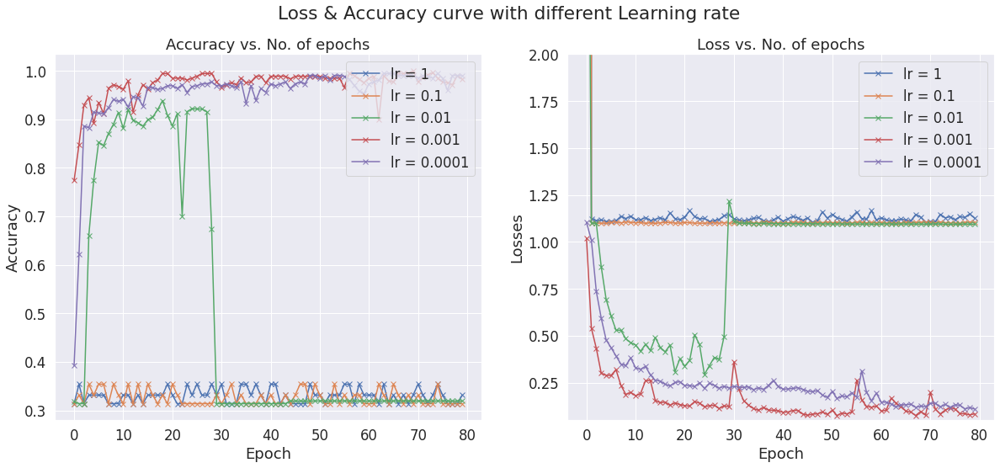

In [ ]:
plot_LR(result,'different Learning rate')

In [ ]:
#choose best optimizer 
history+= optimizer_test(num_epochs, lr, model, train_dl, val_dl, opt_func)
result.append(history)

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.0120, val_loss: 0.6519, train_acc: 0.4494, val_acc: 0.8141


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 0.5569, val_loss: 0.4444, train_acc: 0.7861, val_acc: 0.8793


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.4207, val_loss: 0.2540, train_acc: 0.8266, val_acc: 0.9299


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.2742, val_loss: 0.1760, train_acc: 0.8590, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.2634, val_loss: 0.1373, train_acc: 0.8630, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.2455, val_loss: 0.1731, train_acc: 0.8675, val_acc: 0.9465


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.2289, val_loss: 0.1612, train_acc: 0.8807, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.2016, val_loss: 0.1231, train_acc: 0.8825, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.1722, val_loss: 0.0935, train_acc: 0.8846, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2143, val_loss: 0.0615, train_acc: 0.8708, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.1720, val_loss: 0.0778, train_acc: 0.8754, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.1627, val_loss: 0.0794, train_acc: 0.8938, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1809, val_loss: 0.0643, train_acc: 0.9458, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1607, val_loss: 0.2178, train_acc: 0.9439, val_acc: 0.9416


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1914, val_loss: 0.1437, train_acc: 0.9353, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.1473, val_loss: 0.0260, train_acc: 0.9478, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1347, val_loss: 0.0433, train_acc: 0.9575, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1310, val_loss: 0.0238, train_acc: 0.9524, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.1352, val_loss: 0.0665, train_acc: 0.9511, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1357, val_loss: 0.0456, train_acc: 0.9603, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1343, val_loss: 0.1166, train_acc: 0.9537, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1255, val_loss: 0.0516, train_acc: 0.9563, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1260, val_loss: 0.0861, train_acc: 0.9582, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1454, val_loss: 0.2801, train_acc: 0.9518, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.1997, val_loss: 0.0629, train_acc: 0.9399, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1692, val_loss: 0.1713, train_acc: 0.9530, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1849, val_loss: 0.0866, train_acc: 0.9582, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1414, val_loss: 0.0941, train_acc: 0.9621, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1095, val_loss: 0.0287, train_acc: 0.9739, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1129, val_loss: 0.0750, train_acc: 0.9667, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.1121, val_loss: 0.0591, train_acc: 0.9621, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.1182, val_loss: 0.0322, train_acc: 0.9699, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.0978, val_loss: 0.0121, train_acc: 0.9746, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.1047, val_loss: 0.0145, train_acc: 0.9713, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0960, val_loss: 0.1817, train_acc: 0.9719, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.0852, val_loss: 0.2215, train_acc: 0.9778, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0952, val_loss: 0.0066, train_acc: 0.9739, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0994, val_loss: 0.0079, train_acc: 0.9700, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.2276, val_loss: 0.7102, train_acc: 0.9561, val_acc: 0.7217


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.3883, val_loss: 0.1577, train_acc: 0.8488, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.2324, val_loss: 0.1193, train_acc: 0.8976, val_acc: 0.9683


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.1976, val_loss: 0.0907, train_acc: 0.9479, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.1255, val_loss: 0.0900, train_acc: 0.9641, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.1269, val_loss: 0.0919, train_acc: 0.9628, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0896, val_loss: 0.0396, train_acc: 0.9739, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0821, val_loss: 0.0562, train_acc: 0.9792, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0870, val_loss: 0.0680, train_acc: 0.9765, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0856, val_loss: 0.0656, train_acc: 0.9746, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.1084, val_loss: 0.0505, train_acc: 0.9667, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.1651, val_loss: 0.0669, train_acc: 0.9517, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.1382, val_loss: 0.0918, train_acc: 0.9505, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0950, val_loss: 0.0500, train_acc: 0.9746, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0932, val_loss: 0.1037, train_acc: 0.9706, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0854, val_loss: 0.6064, train_acc: 0.9712, val_acc: 0.9482


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.1442, val_loss: 0.0786, train_acc: 0.9583, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0804, val_loss: 0.0228, train_acc: 0.9772, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0748, val_loss: 0.0400, train_acc: 0.9765, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0825, val_loss: 0.0086, train_acc: 0.9745, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0889, val_loss: 0.0928, train_acc: 0.9681, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0893, val_loss: 0.1823, train_acc: 0.9713, val_acc: 0.9716


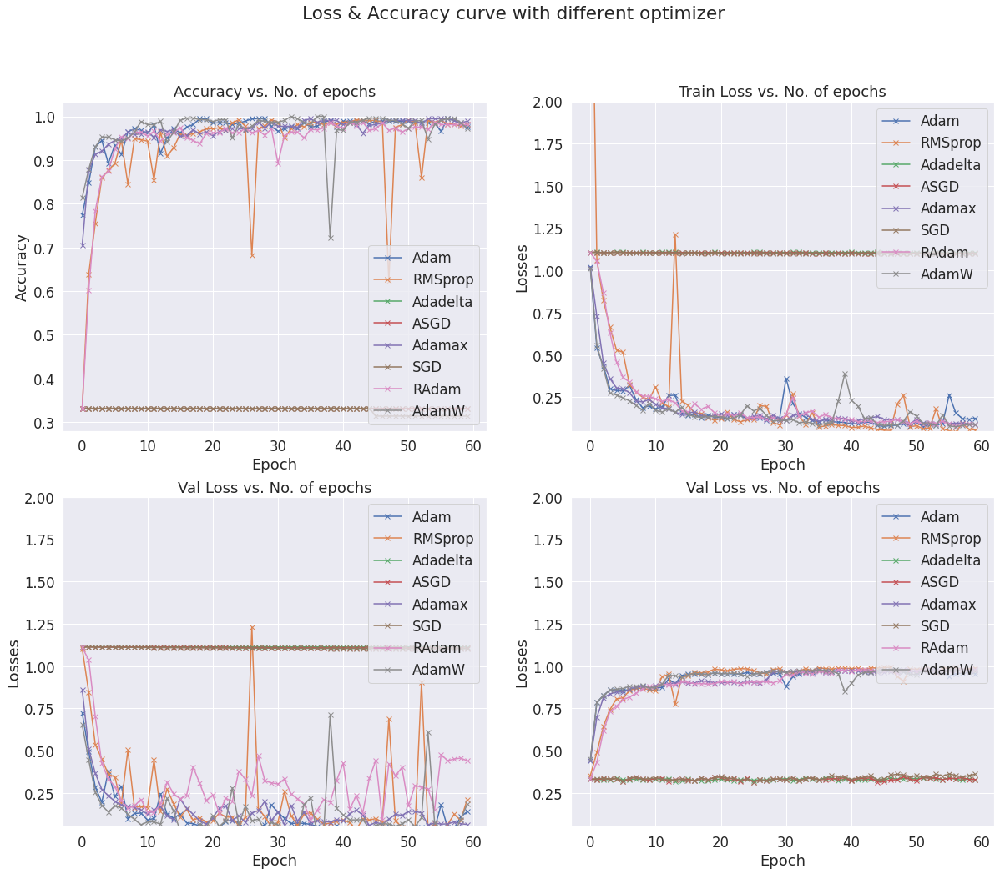

In [ ]:
plot_opt(result,'different optimizer')

In [ ]:
###choose best batch size
history+= fit(num_epochs, lr, model, train_dl, val_dl, opt_func)
result.append(history)

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.0947, val_loss: 1.1554, train_acc: 0.3570, val_acc: 0.4450


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0653, val_loss: 0.9866, train_acc: 0.4051, val_acc: 0.5550


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.9327, val_loss: 0.7913, train_acc: 0.5049, val_acc: 0.6009


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.7530, val_loss: 0.6397, train_acc: 0.5637, val_acc: 0.6376


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.6746, val_loss: 0.6260, train_acc: 0.6174, val_acc: 0.7890


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.6133, val_loss: 0.5543, train_acc: 0.7262, val_acc: 0.8991


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.5217, val_loss: 0.4153, train_acc: 0.8350, val_acc: 0.8761


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.4821, val_loss: 0.4116, train_acc: 0.8032, val_acc: 0.9404


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.4744, val_loss: 0.6467, train_acc: 0.8068, val_acc: 0.6468


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.4544, val_loss: 0.3992, train_acc: 0.7966, val_acc: 0.9495


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.4099, val_loss: 0.3387, train_acc: 0.8813, val_acc: 0.9587


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.3837, val_loss: 0.3843, train_acc: 0.8825, val_acc: 0.9679


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.3423, val_loss: 0.2414, train_acc: 0.8807, val_acc: 0.9679


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.3735, val_loss: 0.3264, train_acc: 0.8377, val_acc: 0.9541


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.4328, val_loss: 0.5247, train_acc: 0.8406, val_acc: 0.7890


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.5032, val_loss: 0.2879, train_acc: 0.8421, val_acc: 0.9266


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.2818, val_loss: 0.2293, train_acc: 0.8656, val_acc: 0.9220


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.2213, val_loss: 0.1143, train_acc: 0.8839, val_acc: 0.9725


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.2003, val_loss: 0.3039, train_acc: 0.8852, val_acc: 0.9633


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1925, val_loss: 0.1217, train_acc: 0.8813, val_acc: 0.9633


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1613, val_loss: 0.1475, train_acc: 0.8937, val_acc: 0.9725


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1695, val_loss: 0.2213, train_acc: 0.8814, val_acc: 0.9679


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1581, val_loss: 0.1094, train_acc: 0.8897, val_acc: 0.9817


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1628, val_loss: 0.2396, train_acc: 0.8858, val_acc: 0.9725


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.1354, val_loss: 0.1825, train_acc: 0.9028, val_acc: 0.9679


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1329, val_loss: 0.1795, train_acc: 0.9086, val_acc: 0.9771


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1845, val_loss: 0.1975, train_acc: 0.8741, val_acc: 0.9633


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1580, val_loss: 0.1942, train_acc: 0.8969, val_acc: 0.9771


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1484, val_loss: 0.1317, train_acc: 0.8937, val_acc: 0.9771


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1609, val_loss: 0.3126, train_acc: 0.8917, val_acc: 0.9679


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.1258, val_loss: 0.3389, train_acc: 0.9080, val_acc: 0.9725


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.1257, val_loss: 0.1280, train_acc: 0.9028, val_acc: 0.9817


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.1435, val_loss: 0.4407, train_acc: 0.8976, val_acc: 0.9633


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.1411, val_loss: 0.2079, train_acc: 0.8891, val_acc: 0.9725


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.1373, val_loss: 0.1850, train_acc: 0.8970, val_acc: 0.9725


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1420, val_loss: 0.1511, train_acc: 0.8865, val_acc: 0.9817


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.1458, val_loss: 0.1994, train_acc: 0.8897, val_acc: 0.9725


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.1278, val_loss: 0.2302, train_acc: 0.9047, val_acc: 0.9725


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.1310, val_loss: 0.2332, train_acc: 0.8989, val_acc: 0.9725


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.1292, val_loss: 0.2775, train_acc: 0.8988, val_acc: 0.9725


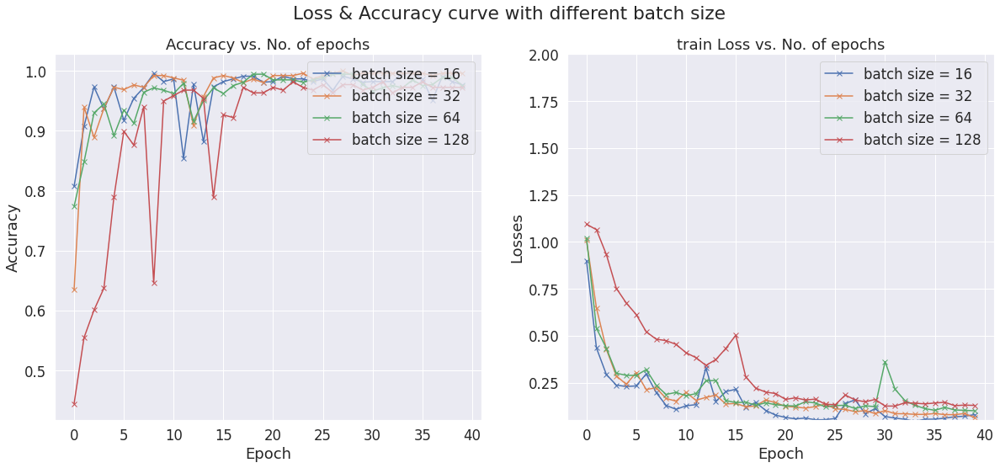

In [ ]:
plot_BS(result,'different batch size')

In [ ]:
###choose best Drop-out value
history+= fit(num_epochs, lr, model, train_dl, val_dl, opt_func)
result.append(history)

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.0920, val_loss: 0.9431, train_acc: 0.3439, val_acc: 0.5701


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 0.9948, val_loss: 0.7734, train_acc: 0.4149, val_acc: 0.6520


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.9672, val_loss: 0.7087, train_acc: 0.4006, val_acc: 0.7818


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.9140, val_loss: 0.5802, train_acc: 0.4684, val_acc: 0.8124


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.8495, val_loss: 0.6167, train_acc: 0.5018, val_acc: 0.8457


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.8039, val_loss: 0.7357, train_acc: 0.5455, val_acc: 0.8318


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.7881, val_loss: 0.3718, train_acc: 0.5319, val_acc: 0.9315


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.6887, val_loss: 0.4462, train_acc: 0.5870, val_acc: 0.9393


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.7511, val_loss: 0.5196, train_acc: 0.5618, val_acc: 0.9354


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.7301, val_loss: 0.4348, train_acc: 0.5368, val_acc: 0.9099


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.6964, val_loss: 0.3523, train_acc: 0.5559, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.7225, val_loss: 0.4393, train_acc: 0.6227, val_acc: 0.9187


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.6707, val_loss: 0.4504, train_acc: 0.6648, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.6514, val_loss: 0.4233, train_acc: 0.6608, val_acc: 0.9465


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.7308, val_loss: 0.3468, train_acc: 0.6426, val_acc: 0.9338


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.7288, val_loss: 0.2959, train_acc: 0.6411, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.7042, val_loss: 0.3642, train_acc: 0.6684, val_acc: 0.9243


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.6759, val_loss: 0.2490, train_acc: 0.6398, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.6392, val_loss: 0.2561, train_acc: 0.6602, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.6595, val_loss: 0.3411, train_acc: 0.6774, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.6650, val_loss: 0.2615, train_acc: 0.6477, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.6637, val_loss: 0.2969, train_acc: 0.6510, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.6691, val_loss: 0.4054, train_acc: 0.6733, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.6602, val_loss: 0.2648, train_acc: 0.6811, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.6122, val_loss: 0.1301, train_acc: 0.6863, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.6395, val_loss: 0.1990, train_acc: 0.6720, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.6235, val_loss: 0.4191, train_acc: 0.6733, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.7367, val_loss: 0.4846, train_acc: 0.6474, val_acc: 0.8731


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.6878, val_loss: 0.2313, train_acc: 0.6459, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.6400, val_loss: 0.1069, train_acc: 0.6725, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.5980, val_loss: 0.4212, train_acc: 0.6914, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.6610, val_loss: 0.2094, train_acc: 0.6647, val_acc: 0.9015


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.6759, val_loss: 0.2377, train_acc: 0.6792, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.6470, val_loss: 0.2207, train_acc: 0.6523, val_acc: 0.9683


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.6309, val_loss: 0.2614, train_acc: 0.6627, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.6224, val_loss: 0.2935, train_acc: 0.6816, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.6302, val_loss: 0.1018, train_acc: 0.6932, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.6692, val_loss: 0.1571, train_acc: 0.6550, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.6383, val_loss: 0.1984, train_acc: 0.6648, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.6023, val_loss: 0.2326, train_acc: 0.6910, val_acc: 0.9661


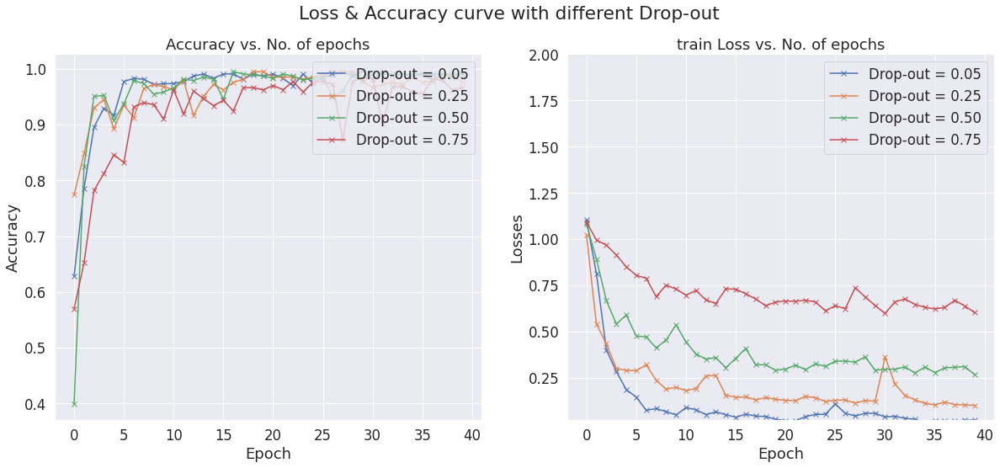

In [ ]:
plot_DP(result,'different Drop-out')

--------------------------------------------------------------------------------------------------------------------- 
**Argument Transformation:**

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 40, 40])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


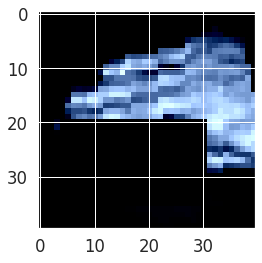

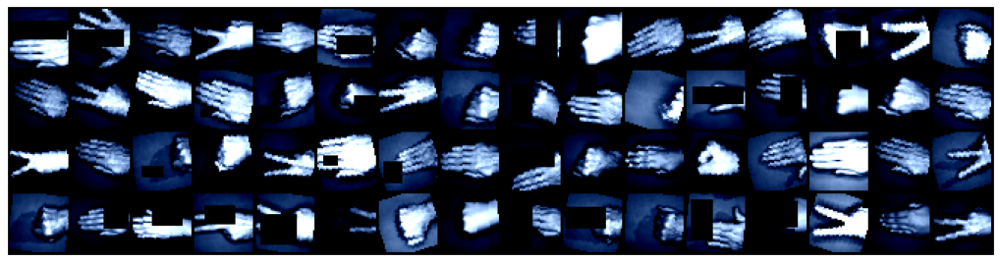

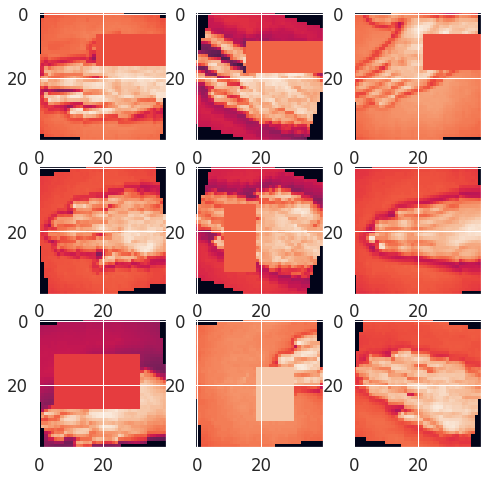

In [ ]:
# Performing Image Transformations.
##Hints: Data Augmentation can be applied here. Have a look on RandomFlip, RandomRotation... 
train_transform=transforms.Compose([
        #transforms.RandomHorizontalFlip(),
        #transforms.RandomVerticalFlip(),
        
       
       
        transforms.Grayscale(num_output_channels=3),
        transforms.Resize(40),             # resize shortest side Hints: larger input size can lead to higher performance
        transforms.CenterCrop(40),         # crop longest side Hints: crop size is usuallt smaller than the resize size
        transforms.RandomRotation(20),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406],
                             [0.229, 0.224, 0.225]),
        transforms.RandomErasing()
])


# Preview one of the images..
def show_image(img, label):
    plt.imshow(img.permute(1,2,0))

dataset = ImageFolder(data_dir, transform=train_transform)
img, label = dataset[100]
print(img.shape)

show_image(*dataset[200])

torch.manual_seed(10)
val_size = len(dataset)//10
test_size = len(dataset)//5
train_size = len(dataset) - val_size - test_size

train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size])
batch_size = 64
train_loader = DataLoader(train_ds, batch_size, shuffle=True, num_workers=2, pin_memory=True)
val_loader = DataLoader(val_ds, batch_size*2, num_workers=2, pin_memory=True)
test_loader = DataLoader(test_ds, batch_size*2, num_workers=2, pin_memory=True)

# Multiple images preview. 
for images, labels in train_loader:
    fig, ax = plt.subplots(figsize=(18,10))
    ax.set_xticks([])
    ax.set_yticks([])
    ax.imshow(make_grid(images, nrow=16).permute(1, 2, 0))
    break


def preview_dataset(train_loader):
    plt.figure(figsize=(8, 8))
    plot_index = 0
    for features in train_loader:
        (image, label) = features
        plot_index += 1
        if plot_index > 9:
          break
        plt.subplot(3, 3, plot_index)
        # plt.axis('Off')
        plt.imshow(image[0].squeeze())

preview_dataset(dataset)
device = get_default_device()
train_loader = DeviceDataLoader(train_loader, device)
val_loader = DeviceDataLoader(val_loader, device)
test_loader = DeviceDataLoader(test_loader, device)
train_dl = DeviceDataLoader(train_loader, device)
val_dl = DeviceDataLoader(val_loader, device)
to_device(model, device)
model = to_device(CnnModel(3), device)
num_epochs = 100
opt_func = torch.optim.Adam
lr = 0.001

In [ ]:
def fit2(epochs, lr, model, train_loader, val_loader, opt_func=torch.optim.Adam):
    history = []
    optimizer = opt_func(model.parameters(), lr)
    for epoch in range(epochs):
        # Training Phase 
        model.train()
        train_losses = []
        train_accuracies = []
        for batch in tqdm(train_loader):
            loss, acc = model.training_step(batch)
            train_losses.append(loss)
            train_accuracies.append(acc)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
        # Validation phase
        result = evaluate(model, val_loader)
        result['train_loss'] = torch.stack(train_losses).mean().item()
        result['train_acc'] = torch.stack(train_accuracies).mean().item()
        model.epoch_end(epoch, result)
        history.append(result)
    return history

In [ ]:
history_list = []

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.0207, val_loss: 0.7785, train_acc: 0.4744, val_acc: 0.5981


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 0.6660, val_loss: 0.5540, train_acc: 0.6973, val_acc: 0.8007


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.5589, val_loss: 0.4990, train_acc: 0.7675, val_acc: 0.8085


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.4651, val_loss: 0.4209, train_acc: 0.8024, val_acc: 0.8669


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.3976, val_loss: 0.3412, train_acc: 0.8480, val_acc: 0.8904


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.3191, val_loss: 0.2538, train_acc: 0.8689, val_acc: 0.9371


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.2318, val_loss: 0.1835, train_acc: 0.8936, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.1974, val_loss: 0.2214, train_acc: 0.9013, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.2384, val_loss: 0.1555, train_acc: 0.9041, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.1549, val_loss: 0.2761, train_acc: 0.9236, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.1545, val_loss: 0.1187, train_acc: 0.9243, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.1311, val_loss: 0.2788, train_acc: 0.9275, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1534, val_loss: 0.2041, train_acc: 0.9270, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1181, val_loss: 0.2121, train_acc: 0.9295, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1269, val_loss: 0.5855, train_acc: 0.9347, val_acc: 0.8986


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.1790, val_loss: 0.0927, train_acc: 0.9270, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1228, val_loss: 0.1222, train_acc: 0.9289, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1013, val_loss: 0.1065, train_acc: 0.9373, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.0844, val_loss: 0.1658, train_acc: 0.9433, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1585, val_loss: 0.3101, train_acc: 0.9261, val_acc: 0.9399


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1573, val_loss: 0.1647, train_acc: 0.9263, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1093, val_loss: 0.2588, train_acc: 0.9290, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.0868, val_loss: 0.1302, train_acc: 0.9387, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1080, val_loss: 0.1811, train_acc: 0.9302, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.0931, val_loss: 0.1135, train_acc: 0.9360, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1064, val_loss: 0.1527, train_acc: 0.9394, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1007, val_loss: 0.1875, train_acc: 0.9289, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.0792, val_loss: 0.1831, train_acc: 0.9497, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.0772, val_loss: 0.2229, train_acc: 0.9589, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.0679, val_loss: 0.3451, train_acc: 0.9588, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.0734, val_loss: 0.4570, train_acc: 0.9544, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.1782, val_loss: 1.2201, train_acc: 0.9577, val_acc: 0.8318


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.5399, val_loss: 0.1852, train_acc: 0.7564, val_acc: 0.9315


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.1956, val_loss: 0.1046, train_acc: 0.9243, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.1472, val_loss: 0.0957, train_acc: 0.9224, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1055, val_loss: 0.2016, train_acc: 0.9341, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.1260, val_loss: 0.1001, train_acc: 0.9230, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.1042, val_loss: 0.2690, train_acc: 0.9380, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.1088, val_loss: 0.1210, train_acc: 0.9328, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.0970, val_loss: 0.1684, train_acc: 0.9341, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0802, val_loss: 0.2323, train_acc: 0.9432, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.0702, val_loss: 0.3601, train_acc: 0.9550, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.1422, val_loss: 0.4607, train_acc: 0.9497, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.1632, val_loss: 0.0847, train_acc: 0.9381, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.1191, val_loss: 0.0734, train_acc: 0.9353, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.1148, val_loss: 0.1675, train_acc: 0.9334, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0815, val_loss: 0.2508, train_acc: 0.9419, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0762, val_loss: 0.2698, train_acc: 0.9452, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.1269, val_loss: 0.0713, train_acc: 0.9622, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.1020, val_loss: 0.0638, train_acc: 0.9446, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0732, val_loss: 0.0972, train_acc: 0.9414, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0850, val_loss: 0.1649, train_acc: 0.9478, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0692, val_loss: 0.1878, train_acc: 0.9590, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0756, val_loss: 0.2077, train_acc: 0.9576, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0835, val_loss: 0.2372, train_acc: 0.9511, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0929, val_loss: 0.1249, train_acc: 0.9569, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0953, val_loss: 0.3577, train_acc: 0.9445, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0733, val_loss: 0.3377, train_acc: 0.9530, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0690, val_loss: 0.1100, train_acc: 0.9616, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0756, val_loss: 0.1928, train_acc: 0.9602, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.1188, val_loss: 0.1147, train_acc: 0.9405, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0933, val_loss: 0.0544, train_acc: 0.9400, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0845, val_loss: 0.0944, train_acc: 0.9576, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0709, val_loss: 0.1011, train_acc: 0.9602, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0792, val_loss: 0.1194, train_acc: 0.9543, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0744, val_loss: 0.1569, train_acc: 0.9550, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0912, val_loss: 0.0651, train_acc: 0.9511, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0879, val_loss: 0.1306, train_acc: 0.9550, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0763, val_loss: 0.2042, train_acc: 0.9563, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0652, val_loss: 0.1074, train_acc: 0.9661, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0636, val_loss: 0.1429, train_acc: 0.9655, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0752, val_loss: 0.2004, train_acc: 0.9549, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0654, val_loss: 0.3686, train_acc: 0.9621, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0695, val_loss: 0.4701, train_acc: 0.9590, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0610, val_loss: 0.6324, train_acc: 0.9654, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0788, val_loss: 0.3002, train_acc: 0.9536, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0594, val_loss: 0.5131, train_acc: 0.9713, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0739, val_loss: 0.1306, train_acc: 0.9517, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0685, val_loss: 0.3078, train_acc: 0.9550, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0637, val_loss: 0.4410, train_acc: 0.9609, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0706, val_loss: 0.7391, train_acc: 0.9511, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0701, val_loss: 0.8393, train_acc: 0.9544, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0745, val_loss: 0.5720, train_acc: 0.9577, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0855, val_loss: 0.0920, train_acc: 0.9590, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0839, val_loss: 0.1302, train_acc: 0.9595, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0722, val_loss: 0.0877, train_acc: 0.9577, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0791, val_loss: 0.0851, train_acc: 0.9570, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.1561, val_loss: 0.4051, train_acc: 0.9437, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.1087, val_loss: 0.8908, train_acc: 0.9446, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.5319, val_loss: 0.4314, train_acc: 0.9079, val_acc: 0.8852


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.2792, val_loss: 0.1384, train_acc: 0.8787, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.1243, val_loss: 0.1278, train_acc: 0.9407, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0993, val_loss: 0.1901, train_acc: 0.9479, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0982, val_loss: 0.2101, train_acc: 0.9465, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.1138, val_loss: 0.1592, train_acc: 0.9400, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0954, val_loss: 0.2572, train_acc: 0.9485, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0776, val_loss: 0.2015, train_acc: 0.9621, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0804, val_loss: 0.1930, train_acc: 0.9544, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0740, val_loss: 0.3399, train_acc: 0.9615, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.1438, val_loss: 0.0527, train_acc: 0.9563, val_acc: 0.9716


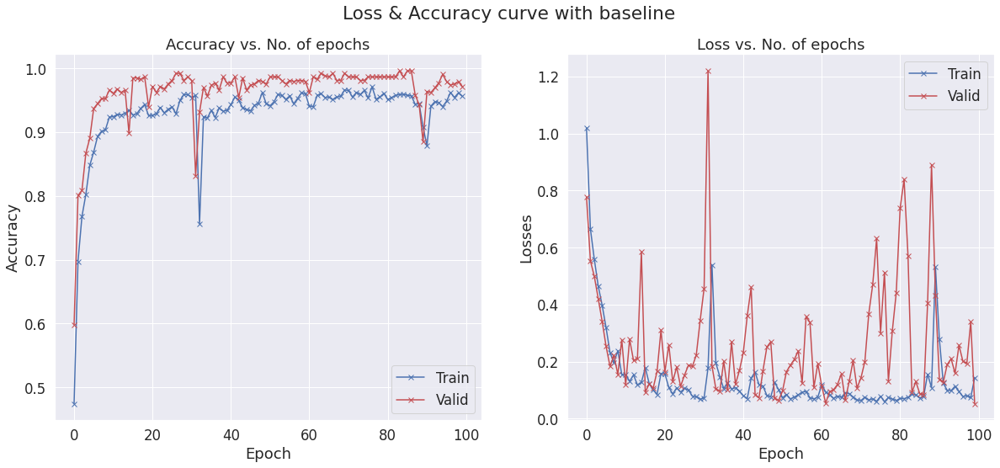

In [ ]:
history_baseline = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_baseline, "baseline")

In [ ]:
history_rotation = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1006, val_loss: 1.1010, train_acc: 0.3405, val_acc: 0.3141


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 0.8838, val_loss: 0.8729, train_acc: 0.5109, val_acc: 0.5714


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.5518, val_loss: 0.3823, train_acc: 0.7471, val_acc: 0.8741


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.3437, val_loss: 0.2424, train_acc: 0.8768, val_acc: 0.9276


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.2511, val_loss: 0.1339, train_acc: 0.9185, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.1488, val_loss: 0.1097, train_acc: 0.9518, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.1906, val_loss: 0.1455, train_acc: 0.9531, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.1535, val_loss: 0.1199, train_acc: 0.9433, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.1581, val_loss: 0.1581, train_acc: 0.9499, val_acc: 0.9549


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.0818, val_loss: 0.0946, train_acc: 0.9694, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.0946, val_loss: 0.1112, train_acc: 0.9609, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.0813, val_loss: 0.0918, train_acc: 0.9667, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.0831, val_loss: 0.2539, train_acc: 0.9680, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1252, val_loss: 0.1258, train_acc: 0.9615, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1183, val_loss: 0.1927, train_acc: 0.9647, val_acc: 0.9354


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.0929, val_loss: 0.0995, train_acc: 0.9707, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.0633, val_loss: 0.1635, train_acc: 0.9752, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.0482, val_loss: 0.0976, train_acc: 0.9811, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.0453, val_loss: 0.0835, train_acc: 0.9811, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1082, val_loss: 0.3405, train_acc: 0.9725, val_acc: 0.9644


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1288, val_loss: 0.1170, train_acc: 0.9596, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.0844, val_loss: 0.0499, train_acc: 0.9668, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.0709, val_loss: 0.1099, train_acc: 0.9824, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.0509, val_loss: 0.0829, train_acc: 0.9739, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.0510, val_loss: 0.1398, train_acc: 0.9817, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.0568, val_loss: 0.1168, train_acc: 0.9805, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.0429, val_loss: 0.3280, train_acc: 0.9824, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.0337, val_loss: 0.1580, train_acc: 0.9896, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1492, val_loss: 0.1781, train_acc: 0.9498, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.0823, val_loss: 0.0837, train_acc: 0.9745, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.0676, val_loss: 0.0680, train_acc: 0.9733, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.0454, val_loss: 0.0957, train_acc: 0.9837, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.0634, val_loss: 0.0724, train_acc: 0.9843, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0471, val_loss: 0.0682, train_acc: 0.9818, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0745, val_loss: 0.1633, train_acc: 0.9798, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.0350, val_loss: 0.0739, train_acc: 0.9902, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0382, val_loss: 0.0607, train_acc: 0.9824, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0342, val_loss: 0.1323, train_acc: 0.9856, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.0296, val_loss: 0.1671, train_acc: 0.9883, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.0643, val_loss: 0.1172, train_acc: 0.9824, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0790, val_loss: 0.0981, train_acc: 0.9778, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.1703, val_loss: 0.2065, train_acc: 0.9674, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0914, val_loss: 0.0433, train_acc: 0.9707, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0446, val_loss: 0.1067, train_acc: 0.9843, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0576, val_loss: 0.0608, train_acc: 0.9791, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0471, val_loss: 0.0302, train_acc: 0.9850, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0477, val_loss: 0.0840, train_acc: 0.9856, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0402, val_loss: 0.1308, train_acc: 0.9850, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0632, val_loss: 0.0174, train_acc: 0.9856, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0836, val_loss: 0.0943, train_acc: 0.9798, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0450, val_loss: 0.0124, train_acc: 0.9824, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0342, val_loss: 0.0337, train_acc: 0.9856, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0308, val_loss: 0.1361, train_acc: 0.9882, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0441, val_loss: 0.0512, train_acc: 0.9856, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0386, val_loss: 0.0225, train_acc: 0.9831, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0318, val_loss: 0.0257, train_acc: 0.9902, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0341, val_loss: 0.0049, train_acc: 0.9902, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0190, val_loss: 0.0026, train_acc: 0.9941, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0259, val_loss: 0.0083, train_acc: 0.9876, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0269, val_loss: 0.0019, train_acc: 0.9896, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0250, val_loss: 0.0919, train_acc: 0.9896, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0244, val_loss: 0.0550, train_acc: 0.9902, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0334, val_loss: 0.0418, train_acc: 0.9869, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0374, val_loss: 0.0075, train_acc: 0.9870, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0392, val_loss: 0.2975, train_acc: 0.9850, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0460, val_loss: 0.1093, train_acc: 0.9863, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0821, val_loss: 0.4224, train_acc: 0.9837, val_acc: 0.9644


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.1510, val_loss: 0.3222, train_acc: 0.9472, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.1051, val_loss: 0.0644, train_acc: 0.9681, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0635, val_loss: 0.0381, train_acc: 0.9798, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0313, val_loss: 0.0130, train_acc: 0.9869, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0270, val_loss: 0.0145, train_acc: 0.9883, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0233, val_loss: 0.3546, train_acc: 0.9896, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0326, val_loss: 0.0037, train_acc: 0.9889, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0900, val_loss: 0.0485, train_acc: 0.9779, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0327, val_loss: 0.3112, train_acc: 0.9850, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0301, val_loss: 0.0403, train_acc: 0.9856, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0252, val_loss: 0.0738, train_acc: 0.9889, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0278, val_loss: 0.0863, train_acc: 0.9896, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0411, val_loss: 0.0074, train_acc: 0.9844, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0583, val_loss: 0.0709, train_acc: 0.9798, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0385, val_loss: 0.0376, train_acc: 0.9870, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0252, val_loss: 0.1355, train_acc: 0.9896, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0342, val_loss: 0.0060, train_acc: 0.9870, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0256, val_loss: 0.0099, train_acc: 0.9896, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0338, val_loss: 0.0279, train_acc: 0.9843, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0314, val_loss: 0.2127, train_acc: 0.9869, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0275, val_loss: 0.0015, train_acc: 0.9889, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0205, val_loss: 0.0776, train_acc: 0.9909, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0254, val_loss: 0.0006, train_acc: 0.9869, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0229, val_loss: 0.0550, train_acc: 0.9902, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0241, val_loss: 0.0027, train_acc: 0.9896, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0278, val_loss: 0.0143, train_acc: 0.9889, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0261, val_loss: 0.0080, train_acc: 0.9870, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0239, val_loss: 0.2091, train_acc: 0.9902, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0307, val_loss: 0.0436, train_acc: 0.9857, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0253, val_loss: 0.0889, train_acc: 0.9889, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0221, val_loss: 0.1988, train_acc: 0.9889, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.1766, val_loss: 0.1386, train_acc: 0.9700, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0709, val_loss: 0.1867, train_acc: 0.9777, val_acc: 0.9866


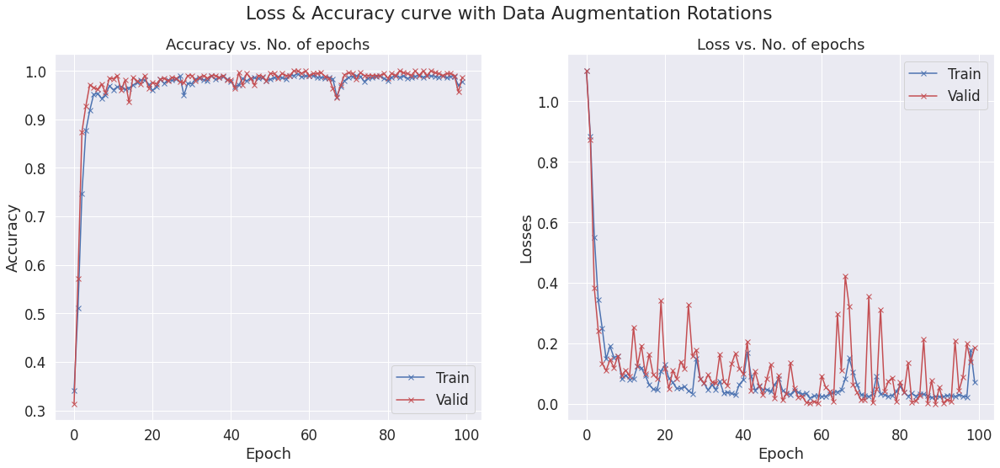

In [ ]:
plot_1(history_rotation, "Data Augmentation Rotations")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.0677, val_loss: 0.8893, train_acc: 0.3950, val_acc: 0.5997


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 0.8631, val_loss: 0.7768, train_acc: 0.5543, val_acc: 0.5946


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.7641, val_loss: 0.7921, train_acc: 0.6205, val_acc: 0.6481


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.6122, val_loss: 0.5546, train_acc: 0.7130, val_acc: 0.7495


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.5454, val_loss: 0.5141, train_acc: 0.7456, val_acc: 0.7740


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.4630, val_loss: 0.4917, train_acc: 0.7796, val_acc: 0.8480


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.4570, val_loss: 0.3999, train_acc: 0.7777, val_acc: 0.8575


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.4245, val_loss: 0.4587, train_acc: 0.8002, val_acc: 0.8196


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.3220, val_loss: 0.2843, train_acc: 0.8636, val_acc: 0.9416


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2442, val_loss: 0.1835, train_acc: 0.9257, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.2059, val_loss: 0.1791, train_acc: 0.9309, val_acc: 0.9488


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.1739, val_loss: 0.1572, train_acc: 0.9412, val_acc: 0.9344


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.2186, val_loss: 0.2285, train_acc: 0.9249, val_acc: 0.9393


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1876, val_loss: 0.3145, train_acc: 0.9424, val_acc: 0.9315


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1724, val_loss: 0.1383, train_acc: 0.9367, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.1202, val_loss: 0.2739, train_acc: 0.9563, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1584, val_loss: 0.1358, train_acc: 0.9458, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1359, val_loss: 0.1074, train_acc: 0.9492, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.1143, val_loss: 0.1550, train_acc: 0.9596, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1006, val_loss: 0.2437, train_acc: 0.9595, val_acc: 0.9377


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1162, val_loss: 0.1620, train_acc: 0.9583, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1318, val_loss: 0.2374, train_acc: 0.9518, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1288, val_loss: 0.1192, train_acc: 0.9544, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1091, val_loss: 0.2387, train_acc: 0.9596, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.0926, val_loss: 0.6289, train_acc: 0.9699, val_acc: 0.9120


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.2284, val_loss: 0.1801, train_acc: 0.9277, val_acc: 0.9416


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1159, val_loss: 0.1898, train_acc: 0.9544, val_acc: 0.9471


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1106, val_loss: 0.1310, train_acc: 0.9563, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.0997, val_loss: 0.0942, train_acc: 0.9680, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.0976, val_loss: 0.0848, train_acc: 0.9647, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.0965, val_loss: 0.0653, train_acc: 0.9661, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.0958, val_loss: 0.0541, train_acc: 0.9660, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.0831, val_loss: 0.1491, train_acc: 0.9680, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0923, val_loss: 0.1182, train_acc: 0.9615, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0902, val_loss: 0.0597, train_acc: 0.9602, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1018, val_loss: 0.1139, train_acc: 0.9707, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0976, val_loss: 0.0272, train_acc: 0.9629, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0744, val_loss: 0.0116, train_acc: 0.9700, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.0630, val_loss: 0.0667, train_acc: 0.9720, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.1122, val_loss: 0.0611, train_acc: 0.9627, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0749, val_loss: 0.0861, train_acc: 0.9706, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.0895, val_loss: 0.0615, train_acc: 0.9707, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0752, val_loss: 0.0338, train_acc: 0.9667, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0892, val_loss: 0.1076, train_acc: 0.9622, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0703, val_loss: 0.0762, train_acc: 0.9680, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0780, val_loss: 0.0349, train_acc: 0.9654, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0637, val_loss: 0.0441, train_acc: 0.9693, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0895, val_loss: 0.0913, train_acc: 0.9603, val_acc: 0.9778


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.1482, val_loss: 0.2057, train_acc: 0.9459, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.1068, val_loss: 0.1831, train_acc: 0.9609, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0915, val_loss: 0.1066, train_acc: 0.9641, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.1082, val_loss: 0.0704, train_acc: 0.9674, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0855, val_loss: 0.1713, train_acc: 0.9614, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0743, val_loss: 0.0520, train_acc: 0.9720, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0686, val_loss: 0.0653, train_acc: 0.9694, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0762, val_loss: 0.0724, train_acc: 0.9687, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0617, val_loss: 0.1894, train_acc: 0.9785, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0757, val_loss: 0.0661, train_acc: 0.9647, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0925, val_loss: 0.0156, train_acc: 0.9687, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0929, val_loss: 0.0721, train_acc: 0.9714, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0603, val_loss: 0.0887, train_acc: 0.9746, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.1015, val_loss: 0.0592, train_acc: 0.9687, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0784, val_loss: 0.0404, train_acc: 0.9713, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0559, val_loss: 0.0628, train_acc: 0.9779, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0711, val_loss: 0.2489, train_acc: 0.9720, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0778, val_loss: 0.0811, train_acc: 0.9674, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0766, val_loss: 0.0203, train_acc: 0.9673, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0542, val_loss: 0.1156, train_acc: 0.9772, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0607, val_loss: 0.0497, train_acc: 0.9778, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0624, val_loss: 0.1010, train_acc: 0.9746, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0748, val_loss: 0.1067, train_acc: 0.9641, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0665, val_loss: 0.1623, train_acc: 0.9694, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0632, val_loss: 0.0775, train_acc: 0.9765, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0756, val_loss: 0.5012, train_acc: 0.9739, val_acc: 0.9058


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.1259, val_loss: 0.0636, train_acc: 0.9491, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0835, val_loss: 0.1717, train_acc: 0.9655, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0955, val_loss: 0.0613, train_acc: 0.9681, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0843, val_loss: 0.0774, train_acc: 0.9661, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0617, val_loss: 0.0516, train_acc: 0.9725, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0500, val_loss: 0.1436, train_acc: 0.9785, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0525, val_loss: 0.1842, train_acc: 0.9785, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0548, val_loss: 0.0512, train_acc: 0.9765, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0595, val_loss: 0.0307, train_acc: 0.9719, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0380, val_loss: 0.1626, train_acc: 0.9824, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0509, val_loss: 0.1754, train_acc: 0.9752, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0461, val_loss: 0.0114, train_acc: 0.9732, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0543, val_loss: 0.0591, train_acc: 0.9719, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0648, val_loss: 0.1109, train_acc: 0.9713, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0417, val_loss: 0.0283, train_acc: 0.9824, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0485, val_loss: 0.0404, train_acc: 0.9746, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0485, val_loss: 0.0262, train_acc: 0.9771, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0498, val_loss: 0.0646, train_acc: 0.9811, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0465, val_loss: 0.1149, train_acc: 0.9733, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0541, val_loss: 0.0041, train_acc: 0.9791, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0670, val_loss: 0.0339, train_acc: 0.9739, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0497, val_loss: 0.0294, train_acc: 0.9746, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0589, val_loss: 0.0295, train_acc: 0.9713, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0359, val_loss: 0.0179, train_acc: 0.9824, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0625, val_loss: 0.0310, train_acc: 0.9660, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0702, val_loss: 0.0862, train_acc: 0.9700, val_acc: 0.9710


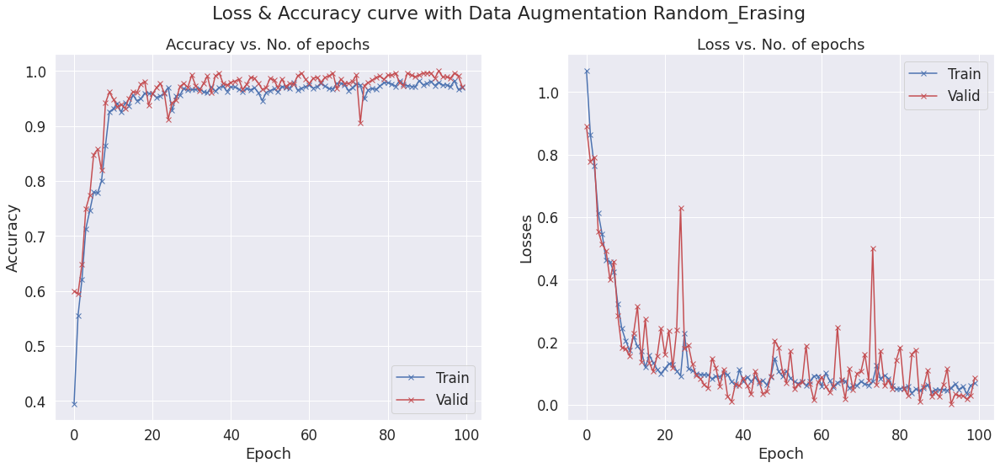

In [ ]:
history_erasing = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_erasing, "Data Augmentation Random_Erasing")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1076, val_loss: 1.1132, train_acc: 0.3502, val_acc: 0.3141


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0475, val_loss: 0.9255, train_acc: 0.4333, val_acc: 0.4957


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.7846, val_loss: 0.6282, train_acc: 0.6225, val_acc: 0.8046


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.5280, val_loss: 0.4321, train_acc: 0.7724, val_acc: 0.8108


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.3914, val_loss: 0.2130, train_acc: 0.8507, val_acc: 0.9148


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.2716, val_loss: 0.1861, train_acc: 0.8931, val_acc: 0.9393


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.2767, val_loss: 0.2191, train_acc: 0.8889, val_acc: 0.9299


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.1960, val_loss: 0.1325, train_acc: 0.9137, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.1502, val_loss: 0.1271, train_acc: 0.9257, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.1333, val_loss: 0.1147, train_acc: 0.9269, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.1565, val_loss: 0.1341, train_acc: 0.9151, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.1402, val_loss: 0.0741, train_acc: 0.9244, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1117, val_loss: 0.1239, train_acc: 0.9329, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1041, val_loss: 0.0549, train_acc: 0.9346, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.0872, val_loss: 0.1469, train_acc: 0.9407, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.1951, val_loss: 0.1250, train_acc: 0.9243, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1250, val_loss: 0.0916, train_acc: 0.9289, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1178, val_loss: 0.0566, train_acc: 0.9295, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.0916, val_loss: 0.0470, train_acc: 0.9458, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.0832, val_loss: 0.1382, train_acc: 0.9439, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.0733, val_loss: 0.0442, train_acc: 0.9459, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.0698, val_loss: 0.1280, train_acc: 0.9524, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.0797, val_loss: 0.0727, train_acc: 0.9473, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.0847, val_loss: 0.1282, train_acc: 0.9374, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.0744, val_loss: 0.0575, train_acc: 0.9380, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.0734, val_loss: 0.0718, train_acc: 0.9440, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.0741, val_loss: 0.0303, train_acc: 0.9451, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.0673, val_loss: 0.1775, train_acc: 0.9465, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.0720, val_loss: 0.1317, train_acc: 0.9504, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1023, val_loss: 0.1281, train_acc: 0.9405, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.1216, val_loss: 0.0733, train_acc: 0.9420, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.1186, val_loss: 0.1053, train_acc: 0.9523, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.0947, val_loss: 0.0512, train_acc: 0.9485, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0658, val_loss: 0.0544, train_acc: 0.9680, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.1084, val_loss: 0.2658, train_acc: 0.9517, val_acc: 0.9533


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1157, val_loss: 0.2602, train_acc: 0.9524, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.1330, val_loss: 0.0475, train_acc: 0.9412, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0801, val_loss: 0.0486, train_acc: 0.9569, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.0693, val_loss: 0.0278, train_acc: 0.9583, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.0883, val_loss: 0.0254, train_acc: 0.9536, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0742, val_loss: 0.0709, train_acc: 0.9608, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.0679, val_loss: 0.0494, train_acc: 0.9615, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0665, val_loss: 0.0854, train_acc: 0.9615, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0768, val_loss: 0.0436, train_acc: 0.9583, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.2097, val_loss: 0.1816, train_acc: 0.9387, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.1336, val_loss: 0.0623, train_acc: 0.9406, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0910, val_loss: 0.0630, train_acc: 0.9504, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0683, val_loss: 0.0575, train_acc: 0.9589, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0680, val_loss: 0.0484, train_acc: 0.9603, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0786, val_loss: 0.1786, train_acc: 0.9609, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0656, val_loss: 0.0254, train_acc: 0.9648, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0781, val_loss: 0.0313, train_acc: 0.9524, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0642, val_loss: 0.0610, train_acc: 0.9635, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0749, val_loss: 0.0397, train_acc: 0.9549, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0733, val_loss: 0.0279, train_acc: 0.9635, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0668, val_loss: 0.0457, train_acc: 0.9608, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0639, val_loss: 0.0628, train_acc: 0.9654, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0700, val_loss: 0.0856, train_acc: 0.9616, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0523, val_loss: 0.1103, train_acc: 0.9687, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0621, val_loss: 0.0805, train_acc: 0.9668, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0718, val_loss: 0.1247, train_acc: 0.9575, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0686, val_loss: 0.1203, train_acc: 0.9563, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0664, val_loss: 0.0284, train_acc: 0.9576, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0553, val_loss: 0.0148, train_acc: 0.9673, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0600, val_loss: 0.0421, train_acc: 0.9648, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0649, val_loss: 0.0557, train_acc: 0.9614, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0627, val_loss: 0.0724, train_acc: 0.9661, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.2205, val_loss: 0.1130, train_acc: 0.9400, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.1275, val_loss: 0.0486, train_acc: 0.9413, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.1075, val_loss: 0.1154, train_acc: 0.9479, val_acc: 0.9628


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0982, val_loss: 0.0973, train_acc: 0.9491, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0779, val_loss: 0.0255, train_acc: 0.9524, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0839, val_loss: 0.0802, train_acc: 0.9517, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0825, val_loss: 0.0202, train_acc: 0.9517, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0660, val_loss: 0.0761, train_acc: 0.9608, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0897, val_loss: 0.1303, train_acc: 0.9511, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0683, val_loss: 0.0480, train_acc: 0.9602, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0717, val_loss: 0.0705, train_acc: 0.9530, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0660, val_loss: 0.0150, train_acc: 0.9642, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0707, val_loss: 0.0886, train_acc: 0.9635, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0680, val_loss: 0.1330, train_acc: 0.9563, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0587, val_loss: 0.1040, train_acc: 0.9602, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0562, val_loss: 0.0724, train_acc: 0.9655, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0656, val_loss: 0.0550, train_acc: 0.9616, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0659, val_loss: 0.0813, train_acc: 0.9622, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0625, val_loss: 0.1112, train_acc: 0.9595, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0732, val_loss: 0.1475, train_acc: 0.9609, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.1884, val_loss: 0.1071, train_acc: 0.9439, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.1873, val_loss: 0.1532, train_acc: 0.9281, val_acc: 0.9276


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.1247, val_loss: 0.1381, train_acc: 0.9374, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.1100, val_loss: 0.0498, train_acc: 0.9419, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0700, val_loss: 0.0952, train_acc: 0.9576, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0697, val_loss: 0.1094, train_acc: 0.9524, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0793, val_loss: 0.0216, train_acc: 0.9491, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0744, val_loss: 0.0701, train_acc: 0.9531, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0704, val_loss: 0.0731, train_acc: 0.9525, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0658, val_loss: 0.1305, train_acc: 0.9576, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0793, val_loss: 0.1303, train_acc: 0.9530, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0762, val_loss: 0.0567, train_acc: 0.9518, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0695, val_loss: 0.0497, train_acc: 0.9518, val_acc: 0.9866


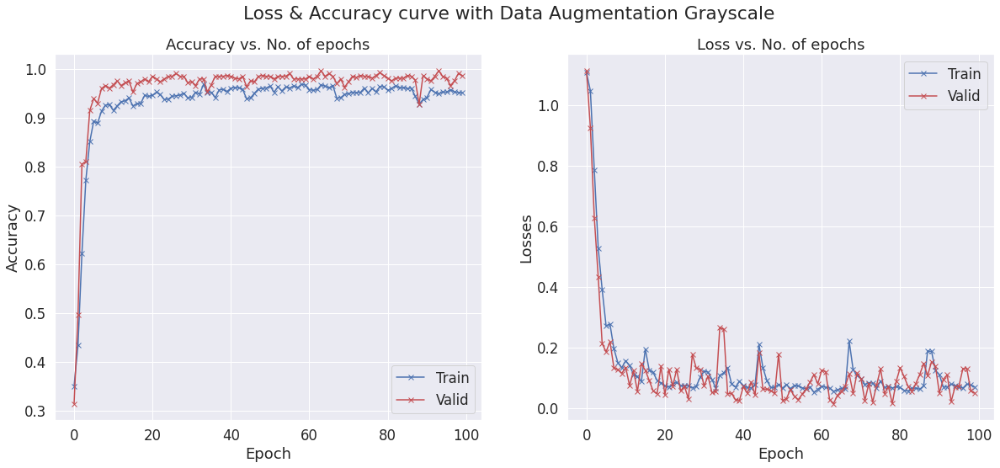

In [ ]:
history_gray = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_gray, "Data Augmentation Grayscale")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1247, val_loss: 1.1056, train_acc: 0.3230, val_acc: 0.3542


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.1085, val_loss: 1.1002, train_acc: 0.3229, val_acc: 0.3542


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 1.0962, val_loss: 1.0102, train_acc: 0.3505, val_acc: 0.5212


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.9747, val_loss: 0.7835, train_acc: 0.4652, val_acc: 0.6224


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.7504, val_loss: 0.5476, train_acc: 0.5246, val_acc: 0.6553


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.5688, val_loss: 0.4114, train_acc: 0.5533, val_acc: 0.6709


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.5317, val_loss: 0.3450, train_acc: 0.7074, val_acc: 0.9282


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.3946, val_loss: 0.1612, train_acc: 0.8610, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.3404, val_loss: 0.1602, train_acc: 0.8688, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2974, val_loss: 0.1000, train_acc: 0.8760, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.3143, val_loss: 0.1234, train_acc: 0.8742, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.2575, val_loss: 0.1057, train_acc: 0.8903, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.2392, val_loss: 0.0962, train_acc: 0.8930, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.2371, val_loss: 0.0733, train_acc: 0.8982, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.2200, val_loss: 0.0709, train_acc: 0.9088, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.2363, val_loss: 0.1120, train_acc: 0.8976, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.2301, val_loss: 0.0595, train_acc: 0.9003, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.2256, val_loss: 0.1506, train_acc: 0.8963, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.2122, val_loss: 0.1516, train_acc: 0.9101, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.2308, val_loss: 0.0826, train_acc: 0.8964, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.2167, val_loss: 0.1234, train_acc: 0.9008, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1971, val_loss: 0.1099, train_acc: 0.9041, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1960, val_loss: 0.0523, train_acc: 0.9100, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1921, val_loss: 0.0608, train_acc: 0.9054, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.2004, val_loss: 0.0499, train_acc: 0.9054, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.2087, val_loss: 0.0382, train_acc: 0.8956, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.2162, val_loss: 0.0676, train_acc: 0.8897, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.2289, val_loss: 0.0900, train_acc: 0.8981, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1930, val_loss: 0.2478, train_acc: 0.9060, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.3487, val_loss: 0.0781, train_acc: 0.8669, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.2110, val_loss: 0.0694, train_acc: 0.8968, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.1907, val_loss: 0.0633, train_acc: 0.9081, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.2024, val_loss: 0.0233, train_acc: 0.8975, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.1791, val_loss: 0.0583, train_acc: 0.9081, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.1897, val_loss: 0.0396, train_acc: 0.9164, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1776, val_loss: 0.0584, train_acc: 0.9015, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.1838, val_loss: 0.0325, train_acc: 0.9093, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.1997, val_loss: 0.1367, train_acc: 0.9015, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.1987, val_loss: 0.1194, train_acc: 0.9007, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.1970, val_loss: 0.0467, train_acc: 0.8974, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.1751, val_loss: 0.0299, train_acc: 0.9106, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.1734, val_loss: 0.0399, train_acc: 0.9139, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.1740, val_loss: 0.0111, train_acc: 0.9080, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.1809, val_loss: 0.0091, train_acc: 0.8962, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.1816, val_loss: 0.0446, train_acc: 0.9120, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.1708, val_loss: 0.0886, train_acc: 0.9112, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.1598, val_loss: 0.0423, train_acc: 0.9094, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.1775, val_loss: 0.0724, train_acc: 0.9013, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.1653, val_loss: 0.1046, train_acc: 0.9132, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.1658, val_loss: 0.0448, train_acc: 0.9184, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.1690, val_loss: 0.0562, train_acc: 0.9100, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.1669, val_loss: 0.0602, train_acc: 0.9106, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.1817, val_loss: 0.1140, train_acc: 0.9015, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.2074, val_loss: 0.0897, train_acc: 0.9093, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.1861, val_loss: 0.0692, train_acc: 0.9067, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.1724, val_loss: 0.0207, train_acc: 0.9060, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.1650, val_loss: 0.0252, train_acc: 0.9062, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.1435, val_loss: 0.0108, train_acc: 0.9283, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.1692, val_loss: 0.0217, train_acc: 0.9087, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.1544, val_loss: 0.0178, train_acc: 0.9218, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.1502, val_loss: 0.0264, train_acc: 0.9166, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.1441, val_loss: 0.0459, train_acc: 0.9212, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.2268, val_loss: 0.1284, train_acc: 0.9028, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.2116, val_loss: 0.0471, train_acc: 0.8853, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.1731, val_loss: 0.0854, train_acc: 0.9093, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.1656, val_loss: 0.0538, train_acc: 0.9055, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.2083, val_loss: 0.0814, train_acc: 0.9016, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.1803, val_loss: 0.1180, train_acc: 0.9061, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.1589, val_loss: 0.1042, train_acc: 0.9126, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.1654, val_loss: 0.0565, train_acc: 0.9081, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.1606, val_loss: 0.0530, train_acc: 0.9035, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.1804, val_loss: 0.0457, train_acc: 0.9022, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.1658, val_loss: 0.1111, train_acc: 0.9009, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.1802, val_loss: 0.1358, train_acc: 0.8996, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.1922, val_loss: 0.0442, train_acc: 0.9008, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.1720, val_loss: 0.1016, train_acc: 0.8951, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.1680, val_loss: 0.0404, train_acc: 0.9081, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.1346, val_loss: 0.0245, train_acc: 0.9303, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.1091, val_loss: 0.0680, train_acc: 0.9166, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.1024, val_loss: 0.0553, train_acc: 0.9766, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0991, val_loss: 0.0127, train_acc: 0.9693, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0981, val_loss: 0.0311, train_acc: 0.9700, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.1629, val_loss: 0.0330, train_acc: 0.9719, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.1553, val_loss: 0.0802, train_acc: 0.9616, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.1054, val_loss: 0.1062, train_acc: 0.9739, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.1010, val_loss: 0.0520, train_acc: 0.9765, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0889, val_loss: 0.0606, train_acc: 0.9719, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0910, val_loss: 0.0664, train_acc: 0.9732, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0952, val_loss: 0.0288, train_acc: 0.9661, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0942, val_loss: 0.0378, train_acc: 0.9713, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0859, val_loss: 0.0396, train_acc: 0.9725, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0982, val_loss: 0.0128, train_acc: 0.9655, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.1308, val_loss: 0.0638, train_acc: 0.9563, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.1031, val_loss: 0.0693, train_acc: 0.9667, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0841, val_loss: 0.0720, train_acc: 0.9726, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.1005, val_loss: 0.0679, train_acc: 0.9668, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.1020, val_loss: 0.0902, train_acc: 0.9674, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.1060, val_loss: 0.0278, train_acc: 0.9752, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0969, val_loss: 0.0290, train_acc: 0.9641, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0969, val_loss: 0.0141, train_acc: 0.9668, val_acc: 0.9961


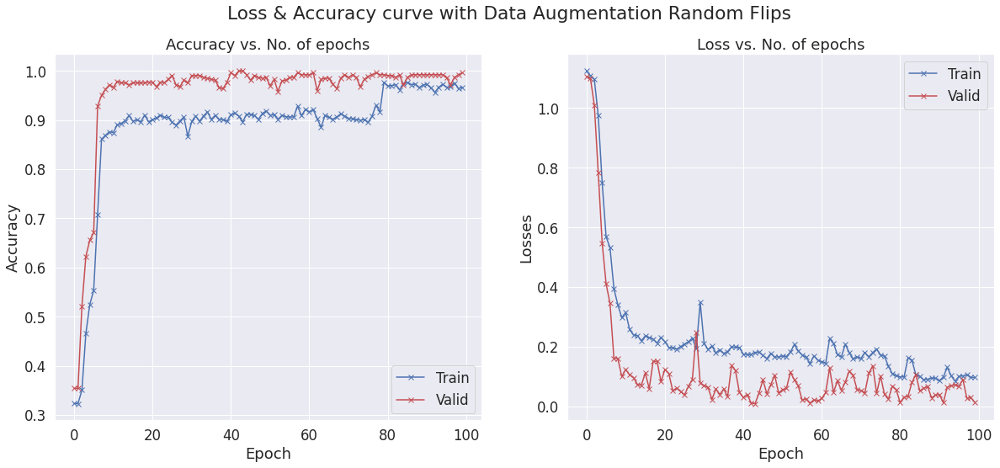

In [ ]:
history_flip = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_flip, "Data Augmentation Random Flips")

In [ ]:
history_rotation_erasing = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.0940, val_loss: 1.0359, train_acc: 0.3457, val_acc: 0.3904


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 0.8327, val_loss: 0.6658, train_acc: 0.5813, val_acc: 0.7612


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.5972, val_loss: 0.6448, train_acc: 0.7426, val_acc: 0.8235


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.4200, val_loss: 0.3728, train_acc: 0.8558, val_acc: 0.8581


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.3395, val_loss: 0.2638, train_acc: 0.8689, val_acc: 0.8992


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.2821, val_loss: 0.2438, train_acc: 0.8911, val_acc: 0.9165


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.2752, val_loss: 0.2389, train_acc: 0.8989, val_acc: 0.9204


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.2728, val_loss: 0.2199, train_acc: 0.8872, val_acc: 0.9498


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.2094, val_loss: 0.1993, train_acc: 0.9184, val_acc: 0.9175


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2060, val_loss: 0.1941, train_acc: 0.9120, val_acc: 0.9465


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.2106, val_loss: 0.3493, train_acc: 0.9035, val_acc: 0.8976


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.2124, val_loss: 0.1154, train_acc: 0.9178, val_acc: 0.9443


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1472, val_loss: 0.1683, train_acc: 0.9360, val_acc: 0.9204


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1628, val_loss: 0.0833, train_acc: 0.9309, val_acc: 0.9471


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1631, val_loss: 0.2597, train_acc: 0.9374, val_acc: 0.9181


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.1978, val_loss: 0.1717, train_acc: 0.9257, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1588, val_loss: 0.1260, train_acc: 0.9399, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1398, val_loss: 0.0909, train_acc: 0.9413, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.1125, val_loss: 0.1193, train_acc: 0.9537, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1295, val_loss: 0.1275, train_acc: 0.9544, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1425, val_loss: 0.0682, train_acc: 0.9485, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1049, val_loss: 0.2490, train_acc: 0.9530, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1062, val_loss: 0.0772, train_acc: 0.9530, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1271, val_loss: 0.0813, train_acc: 0.9459, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.1072, val_loss: 0.1110, train_acc: 0.9595, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1452, val_loss: 0.0881, train_acc: 0.9420, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1179, val_loss: 0.1280, train_acc: 0.9608, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.0963, val_loss: 0.0504, train_acc: 0.9635, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1280, val_loss: 0.0705, train_acc: 0.9459, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1032, val_loss: 0.1409, train_acc: 0.9654, val_acc: 0.9560


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.1097, val_loss: 0.0286, train_acc: 0.9596, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.0888, val_loss: 0.0616, train_acc: 0.9648, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.1049, val_loss: 0.1476, train_acc: 0.9516, val_acc: 0.9276


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.1211, val_loss: 0.1220, train_acc: 0.9517, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0826, val_loss: 0.0937, train_acc: 0.9609, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1508, val_loss: 0.1236, train_acc: 0.9471, val_acc: 0.9482


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0989, val_loss: 0.1041, train_acc: 0.9537, val_acc: 0.9576


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0997, val_loss: 0.0619, train_acc: 0.9615, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.0955, val_loss: 0.1080, train_acc: 0.9576, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.1284, val_loss: 0.0854, train_acc: 0.9464, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0861, val_loss: 0.1515, train_acc: 0.9642, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.1003, val_loss: 0.1653, train_acc: 0.9615, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0857, val_loss: 0.1342, train_acc: 0.9622, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.1218, val_loss: 0.0819, train_acc: 0.9543, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.1050, val_loss: 0.0421, train_acc: 0.9576, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0985, val_loss: 0.0705, train_acc: 0.9563, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0649, val_loss: 0.1333, train_acc: 0.9699, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0867, val_loss: 0.0509, train_acc: 0.9569, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.1007, val_loss: 0.1063, train_acc: 0.9642, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0746, val_loss: 0.0496, train_acc: 0.9681, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0791, val_loss: 0.0855, train_acc: 0.9583, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0895, val_loss: 0.1022, train_acc: 0.9628, val_acc: 0.9488


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.1033, val_loss: 0.0809, train_acc: 0.9523, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0733, val_loss: 0.0618, train_acc: 0.9641, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0796, val_loss: 0.0258, train_acc: 0.9583, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0608, val_loss: 0.1515, train_acc: 0.9706, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0778, val_loss: 0.0085, train_acc: 0.9681, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0933, val_loss: 0.0620, train_acc: 0.9622, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0868, val_loss: 0.0612, train_acc: 0.9674, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0671, val_loss: 0.1093, train_acc: 0.9707, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.1392, val_loss: 0.1002, train_acc: 0.9518, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0841, val_loss: 0.0887, train_acc: 0.9641, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.1147, val_loss: 0.0954, train_acc: 0.9505, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0736, val_loss: 0.0755, train_acc: 0.9693, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0896, val_loss: 0.0777, train_acc: 0.9616, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0724, val_loss: 0.0682, train_acc: 0.9726, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0634, val_loss: 0.0890, train_acc: 0.9726, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0864, val_loss: 0.0577, train_acc: 0.9628, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.1027, val_loss: 0.0603, train_acc: 0.9576, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0869, val_loss: 0.0262, train_acc: 0.9635, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0592, val_loss: 0.0671, train_acc: 0.9720, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0614, val_loss: 0.0707, train_acc: 0.9739, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0697, val_loss: 0.0212, train_acc: 0.9687, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.1106, val_loss: 0.1969, train_acc: 0.9485, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0969, val_loss: 0.0395, train_acc: 0.9556, val_acc: 0.9805


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0914, val_loss: 0.0466, train_acc: 0.9686, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0682, val_loss: 0.0295, train_acc: 0.9673, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0599, val_loss: 0.0600, train_acc: 0.9758, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0656, val_loss: 0.0444, train_acc: 0.9719, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0776, val_loss: 0.1268, train_acc: 0.9674, val_acc: 0.9521


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0829, val_loss: 0.0452, train_acc: 0.9655, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0627, val_loss: 0.0474, train_acc: 0.9713, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0970, val_loss: 0.0823, train_acc: 0.9550, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0792, val_loss: 0.0288, train_acc: 0.9679, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0696, val_loss: 0.0570, train_acc: 0.9674, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0588, val_loss: 0.0575, train_acc: 0.9745, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0784, val_loss: 0.0395, train_acc: 0.9648, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0714, val_loss: 0.0282, train_acc: 0.9667, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0544, val_loss: 0.0529, train_acc: 0.9772, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0525, val_loss: 0.0078, train_acc: 0.9778, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0781, val_loss: 0.0602, train_acc: 0.9622, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0672, val_loss: 0.0137, train_acc: 0.9655, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0713, val_loss: 0.0295, train_acc: 0.9720, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0739, val_loss: 0.0512, train_acc: 0.9740, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0773, val_loss: 0.0513, train_acc: 0.9641, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0726, val_loss: 0.0702, train_acc: 0.9680, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0666, val_loss: 0.1296, train_acc: 0.9693, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0578, val_loss: 0.0224, train_acc: 0.9687, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0659, val_loss: 0.0843, train_acc: 0.9634, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0841, val_loss: 0.0637, train_acc: 0.9680, val_acc: 0.9749


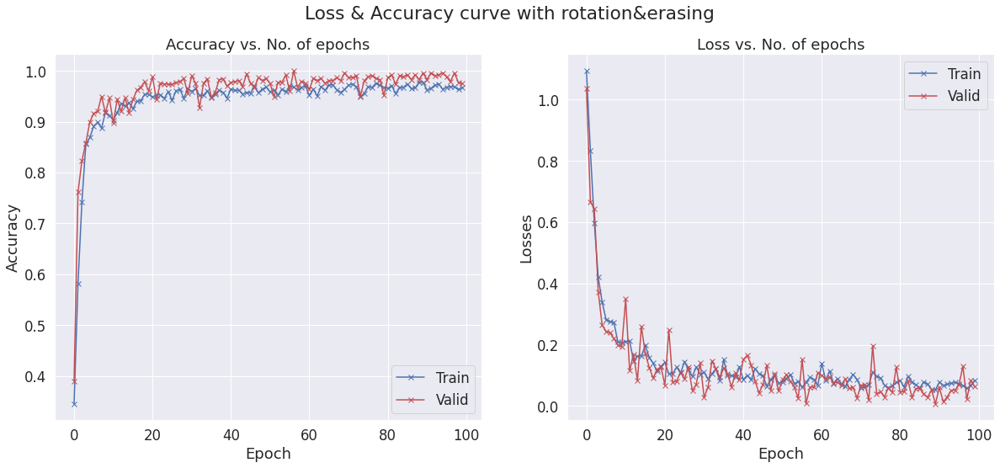

In [ ]:
plot_1(history_rotation_erasing, "rotation&erasing")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1049, val_loss: 1.1015, train_acc: 0.3471, val_acc: 0.3141


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0941, val_loss: 1.0408, train_acc: 0.3909, val_acc: 0.4667


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.9174, val_loss: 0.7442, train_acc: 0.5677, val_acc: 0.7372


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.5876, val_loss: 0.4457, train_acc: 0.7561, val_acc: 0.8307


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.3767, val_loss: 0.2815, train_acc: 0.8592, val_acc: 0.9371


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.2299, val_loss: 0.2306, train_acc: 0.9146, val_acc: 0.9120


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.2271, val_loss: 0.1902, train_acc: 0.9289, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.1468, val_loss: 0.1832, train_acc: 0.9368, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.1375, val_loss: 0.1082, train_acc: 0.9466, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.1049, val_loss: 0.0651, train_acc: 0.9556, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.1415, val_loss: 0.1594, train_acc: 0.9536, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.1177, val_loss: 0.0904, train_acc: 0.9465, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1024, val_loss: 0.1660, train_acc: 0.9563, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.0871, val_loss: 0.1120, train_acc: 0.9660, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1389, val_loss: 0.1509, train_acc: 0.9445, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.0687, val_loss: 0.1310, train_acc: 0.9707, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.0645, val_loss: 0.0682, train_acc: 0.9713, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.0709, val_loss: 0.0866, train_acc: 0.9674, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.0693, val_loss: 0.0732, train_acc: 0.9771, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.0635, val_loss: 0.0333, train_acc: 0.9713, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.0597, val_loss: 0.0572, train_acc: 0.9752, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.0631, val_loss: 0.1903, train_acc: 0.9700, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.0576, val_loss: 0.0785, train_acc: 0.9843, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.0885, val_loss: 0.0833, train_acc: 0.9667, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.0632, val_loss: 0.0777, train_acc: 0.9726, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.0506, val_loss: 0.0495, train_acc: 0.9818, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.0507, val_loss: 0.1471, train_acc: 0.9811, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.0613, val_loss: 0.2571, train_acc: 0.9811, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1046, val_loss: 0.1240, train_acc: 0.9654, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.0658, val_loss: 0.0811, train_acc: 0.9798, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.0594, val_loss: 0.0528, train_acc: 0.9778, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.0385, val_loss: 0.0479, train_acc: 0.9857, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.0306, val_loss: 0.0561, train_acc: 0.9922, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0647, val_loss: 0.0339, train_acc: 0.9766, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0616, val_loss: 0.0247, train_acc: 0.9811, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.0303, val_loss: 0.0818, train_acc: 0.9902, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0452, val_loss: 0.0462, train_acc: 0.9811, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.1144, val_loss: 0.0711, train_acc: 0.9778, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.0569, val_loss: 0.0478, train_acc: 0.9727, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.0547, val_loss: 0.0818, train_acc: 0.9798, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0376, val_loss: 0.1184, train_acc: 0.9863, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.0696, val_loss: 0.1934, train_acc: 0.9778, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0567, val_loss: 0.0802, train_acc: 0.9805, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0330, val_loss: 0.2123, train_acc: 0.9869, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0677, val_loss: 0.1091, train_acc: 0.9798, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.1286, val_loss: 0.1801, train_acc: 0.9746, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0545, val_loss: 0.0863, train_acc: 0.9816, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0672, val_loss: 0.1334, train_acc: 0.9772, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0571, val_loss: 0.0383, train_acc: 0.9843, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0416, val_loss: 0.0284, train_acc: 0.9831, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0329, val_loss: 0.0091, train_acc: 0.9857, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0317, val_loss: 0.0592, train_acc: 0.9863, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0312, val_loss: 0.0608, train_acc: 0.9889, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0548, val_loss: 0.0440, train_acc: 0.9836, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0469, val_loss: 0.0734, train_acc: 0.9804, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0301, val_loss: 0.0249, train_acc: 0.9909, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0248, val_loss: 0.1486, train_acc: 0.9909, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0251, val_loss: 0.0709, train_acc: 0.9935, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0421, val_loss: 0.1505, train_acc: 0.9850, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0329, val_loss: 0.1088, train_acc: 0.9876, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0294, val_loss: 0.1552, train_acc: 0.9876, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0389, val_loss: 0.0956, train_acc: 0.9863, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0453, val_loss: 0.0174, train_acc: 0.9844, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0624, val_loss: 0.0341, train_acc: 0.9844, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0496, val_loss: 0.0065, train_acc: 0.9818, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0365, val_loss: 0.0074, train_acc: 0.9882, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0303, val_loss: 0.0202, train_acc: 0.9896, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0379, val_loss: 0.1685, train_acc: 0.9857, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0327, val_loss: 0.0163, train_acc: 0.9837, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0280, val_loss: 0.0103, train_acc: 0.9870, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0266, val_loss: 0.0824, train_acc: 0.9876, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0284, val_loss: 0.0419, train_acc: 0.9870, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.1078, val_loss: 0.1028, train_acc: 0.9791, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0522, val_loss: 0.0138, train_acc: 0.9876, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.1099, val_loss: 0.1020, train_acc: 0.9713, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0487, val_loss: 0.0156, train_acc: 0.9818, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0389, val_loss: 0.0452, train_acc: 0.9849, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0355, val_loss: 0.0407, train_acc: 0.9843, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0272, val_loss: 0.2456, train_acc: 0.9902, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0385, val_loss: 0.0902, train_acc: 0.9843, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0320, val_loss: 0.0117, train_acc: 0.9863, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0258, val_loss: 0.0286, train_acc: 0.9902, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0305, val_loss: 0.0247, train_acc: 0.9896, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0396, val_loss: 0.0448, train_acc: 0.9850, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0351, val_loss: 0.0303, train_acc: 0.9863, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0648, val_loss: 0.0082, train_acc: 0.9797, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0459, val_loss: 0.2346, train_acc: 0.9811, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0402, val_loss: 0.2943, train_acc: 0.9850, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0886, val_loss: 0.3098, train_acc: 0.9797, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0445, val_loss: 0.0315, train_acc: 0.9817, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0386, val_loss: 0.0296, train_acc: 0.9876, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0297, val_loss: 0.0570, train_acc: 0.9876, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0394, val_loss: 0.0294, train_acc: 0.9876, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0388, val_loss: 0.0158, train_acc: 0.9837, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0415, val_loss: 0.0190, train_acc: 0.9818, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0356, val_loss: 0.0090, train_acc: 0.9857, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0323, val_loss: 0.0261, train_acc: 0.9862, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0267, val_loss: 0.0331, train_acc: 0.9883, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.1247, val_loss: 0.0484, train_acc: 0.9595, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0335, val_loss: 0.0560, train_acc: 0.9863, val_acc: 0.9866


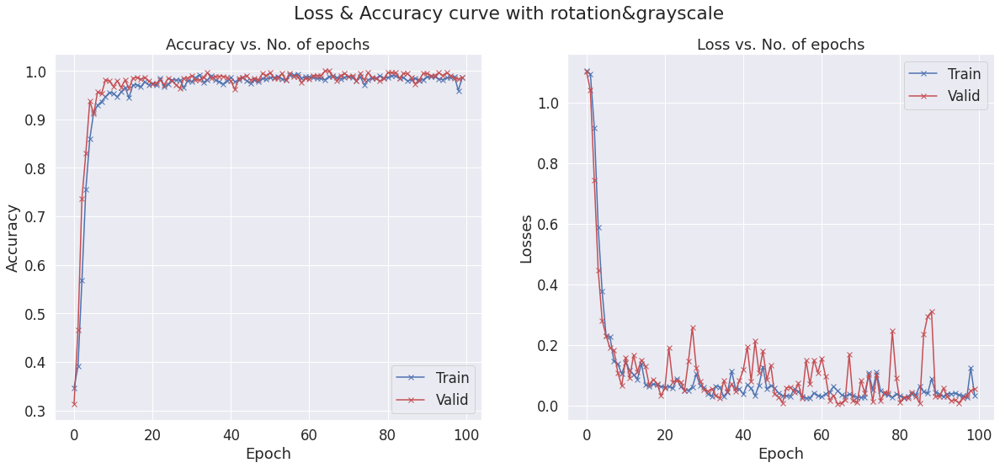

In [ ]:
history_rotation_grayscale = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_rotation_grayscale, "rotation&grayscale")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1067, val_loss: 1.1081, train_acc: 0.3497, val_acc: 0.3141


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0965, val_loss: 1.0743, train_acc: 0.3584, val_acc: 0.5016


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.9418, val_loss: 0.6684, train_acc: 0.5658, val_acc: 0.6325


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.5374, val_loss: 0.2680, train_acc: 0.7621, val_acc: 0.9009


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.3348, val_loss: 0.2051, train_acc: 0.8845, val_acc: 0.9243


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.3273, val_loss: 0.2229, train_acc: 0.8904, val_acc: 0.9377


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.2560, val_loss: 0.1874, train_acc: 0.9251, val_acc: 0.9471


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.1992, val_loss: 0.1742, train_acc: 0.9400, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.2104, val_loss: 0.2980, train_acc: 0.9281, val_acc: 0.9237


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.1672, val_loss: 0.1268, train_acc: 0.9471, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.1001, val_loss: 0.1317, train_acc: 0.9661, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.0909, val_loss: 0.1044, train_acc: 0.9666, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1500, val_loss: 0.0652, train_acc: 0.9551, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1394, val_loss: 0.1328, train_acc: 0.9497, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.0973, val_loss: 0.0926, train_acc: 0.9688, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.0753, val_loss: 0.0560, train_acc: 0.9740, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1421, val_loss: 0.0961, train_acc: 0.9622, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1023, val_loss: 0.1588, train_acc: 0.9628, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.0765, val_loss: 0.0696, train_acc: 0.9771, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.0716, val_loss: 0.0647, train_acc: 0.9726, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.0605, val_loss: 0.0416, train_acc: 0.9732, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.0502, val_loss: 0.0328, train_acc: 0.9804, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.0749, val_loss: 0.1325, train_acc: 0.9701, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.0548, val_loss: 0.0428, train_acc: 0.9805, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.1333, val_loss: 0.0487, train_acc: 0.9537, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.0471, val_loss: 0.0349, train_acc: 0.9785, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.0450, val_loss: 0.1208, train_acc: 0.9817, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.0870, val_loss: 0.1102, train_acc: 0.9706, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.0700, val_loss: 0.1128, train_acc: 0.9766, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.0417, val_loss: 0.0672, train_acc: 0.9824, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.0439, val_loss: 0.0870, train_acc: 0.9811, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.0480, val_loss: 0.0402, train_acc: 0.9837, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.1180, val_loss: 0.0316, train_acc: 0.9707, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0485, val_loss: 0.0739, train_acc: 0.9811, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0666, val_loss: 0.0219, train_acc: 0.9753, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1155, val_loss: 0.0985, train_acc: 0.9602, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0705, val_loss: 0.0432, train_acc: 0.9779, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0617, val_loss: 0.0205, train_acc: 0.9785, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.0814, val_loss: 0.0562, train_acc: 0.9792, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.0572, val_loss: 0.0788, train_acc: 0.9751, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0361, val_loss: 0.0722, train_acc: 0.9811, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.0369, val_loss: 0.0938, train_acc: 0.9843, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0406, val_loss: 0.0059, train_acc: 0.9831, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0763, val_loss: 0.0795, train_acc: 0.9751, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0542, val_loss: 0.0330, train_acc: 0.9713, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0321, val_loss: 0.0373, train_acc: 0.9863, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0820, val_loss: 0.0568, train_acc: 0.9687, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0484, val_loss: 0.0089, train_acc: 0.9785, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0496, val_loss: 0.0641, train_acc: 0.9804, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0479, val_loss: 0.0088, train_acc: 0.9759, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0697, val_loss: 0.0971, train_acc: 0.9805, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0497, val_loss: 0.0032, train_acc: 0.9792, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0405, val_loss: 0.0094, train_acc: 0.9778, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0384, val_loss: 0.0232, train_acc: 0.9830, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0536, val_loss: 0.1458, train_acc: 0.9759, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0369, val_loss: 0.0067, train_acc: 0.9850, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0415, val_loss: 0.0669, train_acc: 0.9811, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0331, val_loss: 0.0087, train_acc: 0.9850, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0466, val_loss: 0.0499, train_acc: 0.9817, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0355, val_loss: 0.0093, train_acc: 0.9804, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0291, val_loss: 0.0089, train_acc: 0.9836, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0374, val_loss: 0.0062, train_acc: 0.9804, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0467, val_loss: 0.0504, train_acc: 0.9798, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0366, val_loss: 0.0100, train_acc: 0.9817, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0478, val_loss: 0.1089, train_acc: 0.9765, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0741, val_loss: 0.1095, train_acc: 0.9706, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0524, val_loss: 0.0077, train_acc: 0.9758, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0331, val_loss: 0.0226, train_acc: 0.9830, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0290, val_loss: 0.0656, train_acc: 0.9843, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0528, val_loss: 0.0840, train_acc: 0.9739, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0333, val_loss: 0.0105, train_acc: 0.9785, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0341, val_loss: 0.0020, train_acc: 0.9798, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0154, val_loss: 0.0158, train_acc: 0.9909, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0245, val_loss: 0.0034, train_acc: 0.9856, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0234, val_loss: 0.0283, train_acc: 0.9856, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0269, val_loss: 0.0160, train_acc: 0.9804, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0221, val_loss: 0.0330, train_acc: 0.9844, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0562, val_loss: 0.1674, train_acc: 0.9876, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0825, val_loss: 0.0210, train_acc: 0.9732, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0416, val_loss: 0.0497, train_acc: 0.9805, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0335, val_loss: 0.1070, train_acc: 0.9824, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0357, val_loss: 0.0814, train_acc: 0.9830, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0244, val_loss: 0.0116, train_acc: 0.9850, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0382, val_loss: 0.0113, train_acc: 0.9798, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0367, val_loss: 0.1243, train_acc: 0.9830, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0235, val_loss: 0.0048, train_acc: 0.9869, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0236, val_loss: 0.0002, train_acc: 0.9818, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0433, val_loss: 0.2344, train_acc: 0.9805, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0382, val_loss: 0.0955, train_acc: 0.9811, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0248, val_loss: 0.0070, train_acc: 0.9824, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0272, val_loss: 0.0004, train_acc: 0.9805, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0235, val_loss: 0.0698, train_acc: 0.9830, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.1212, val_loss: 0.2267, train_acc: 0.9654, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.2300, val_loss: 0.2440, train_acc: 0.9296, val_acc: 0.9410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0958, val_loss: 0.0232, train_acc: 0.9668, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.1072, val_loss: 0.0459, train_acc: 0.9759, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0613, val_loss: 0.0073, train_acc: 0.9811, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0605, val_loss: 0.0056, train_acc: 0.9752, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0523, val_loss: 0.0147, train_acc: 0.9739, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0264, val_loss: 0.0289, train_acc: 0.9850, val_acc: 0.9961


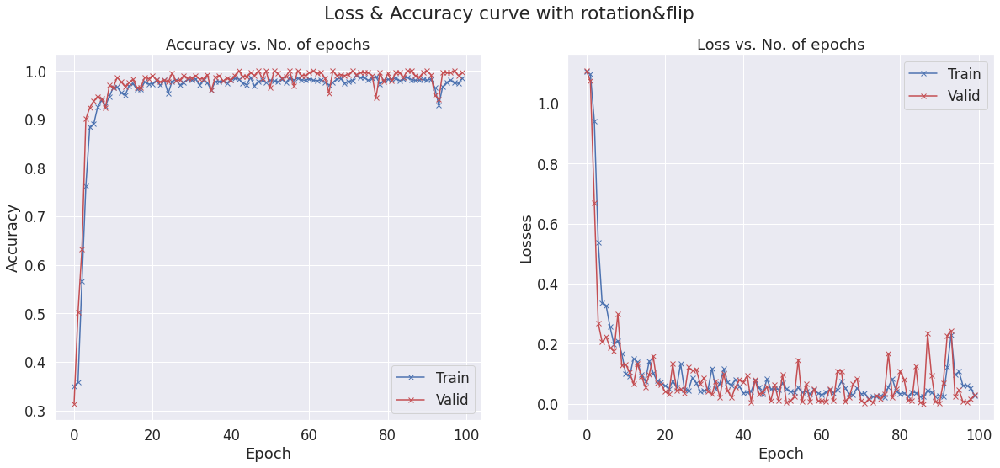

In [ ]:
history_rotation_flip = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_rotation_flip, "rotation&flip")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1184, val_loss: 1.1011, train_acc: 0.3228, val_acc: 0.3542


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.1123, val_loss: 1.0786, train_acc: 0.3280, val_acc: 0.4410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 1.0464, val_loss: 0.9025, train_acc: 0.3977, val_acc: 0.5641


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.7534, val_loss: 0.6323, train_acc: 0.6414, val_acc: 0.7122


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.5434, val_loss: 0.3800, train_acc: 0.7751, val_acc: 0.8468


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.3998, val_loss: 0.3740, train_acc: 0.8487, val_acc: 0.8680


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.3625, val_loss: 0.3487, train_acc: 0.8664, val_acc: 0.8747


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.3599, val_loss: 0.2713, train_acc: 0.8635, val_acc: 0.9159


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.2774, val_loss: 0.2129, train_acc: 0.8904, val_acc: 0.9365


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2241, val_loss: 0.2396, train_acc: 0.9125, val_acc: 0.9410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.1871, val_loss: 0.2491, train_acc: 0.9100, val_acc: 0.9126


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.2225, val_loss: 0.1782, train_acc: 0.9119, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1791, val_loss: 0.1184, train_acc: 0.9185, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1575, val_loss: 0.1595, train_acc: 0.9303, val_acc: 0.9455


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1786, val_loss: 0.2482, train_acc: 0.9347, val_acc: 0.9387


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.2194, val_loss: 0.1388, train_acc: 0.9074, val_acc: 0.9549


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1838, val_loss: 0.1938, train_acc: 0.9203, val_acc: 0.9410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1659, val_loss: 0.1687, train_acc: 0.9309, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.1527, val_loss: 0.1957, train_acc: 0.9433, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1491, val_loss: 0.1000, train_acc: 0.9446, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1488, val_loss: 0.1022, train_acc: 0.9393, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1315, val_loss: 0.1596, train_acc: 0.9484, val_acc: 0.9488


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1281, val_loss: 0.1329, train_acc: 0.9491, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1117, val_loss: 0.1324, train_acc: 0.9511, val_acc: 0.9549


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.1275, val_loss: 0.1725, train_acc: 0.9510, val_acc: 0.9510


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.2252, val_loss: 0.1205, train_acc: 0.9126, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1691, val_loss: 0.0831, train_acc: 0.9386, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1264, val_loss: 0.0791, train_acc: 0.9459, val_acc: 0.9766


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1209, val_loss: 0.1105, train_acc: 0.9457, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1020, val_loss: 0.1177, train_acc: 0.9583, val_acc: 0.9671


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.1130, val_loss: 0.0681, train_acc: 0.9544, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.0860, val_loss: 0.0406, train_acc: 0.9647, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.1357, val_loss: 0.0817, train_acc: 0.9517, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0954, val_loss: 0.1471, train_acc: 0.9570, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.1333, val_loss: 0.1011, train_acc: 0.9479, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1172, val_loss: 0.1244, train_acc: 0.9589, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.1073, val_loss: 0.1190, train_acc: 0.9556, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.1099, val_loss: 0.0646, train_acc: 0.9563, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.1006, val_loss: 0.1284, train_acc: 0.9577, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.1248, val_loss: 0.1158, train_acc: 0.9477, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.1155, val_loss: 0.1443, train_acc: 0.9563, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.1128, val_loss: 0.0897, train_acc: 0.9557, val_acc: 0.9722


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.1277, val_loss: 0.0704, train_acc: 0.9471, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.1024, val_loss: 0.0866, train_acc: 0.9615, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0924, val_loss: 0.0758, train_acc: 0.9609, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0957, val_loss: 0.0364, train_acc: 0.9629, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0907, val_loss: 0.1171, train_acc: 0.9627, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0917, val_loss: 0.1118, train_acc: 0.9582, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0893, val_loss: 0.0394, train_acc: 0.9615, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0839, val_loss: 0.0157, train_acc: 0.9655, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0901, val_loss: 0.0776, train_acc: 0.9590, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.1042, val_loss: 0.0834, train_acc: 0.9653, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.1130, val_loss: 0.0763, train_acc: 0.9497, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0771, val_loss: 0.0502, train_acc: 0.9641, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.1212, val_loss: 0.0658, train_acc: 0.9557, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0798, val_loss: 0.0431, train_acc: 0.9680, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0816, val_loss: 0.0404, train_acc: 0.9655, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.1034, val_loss: 0.1471, train_acc: 0.9635, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.1019, val_loss: 0.0394, train_acc: 0.9576, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0872, val_loss: 0.0719, train_acc: 0.9687, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0876, val_loss: 0.0570, train_acc: 0.9648, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0723, val_loss: 0.0322, train_acc: 0.9674, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.1021, val_loss: 0.0513, train_acc: 0.9544, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0779, val_loss: 0.0603, train_acc: 0.9647, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0725, val_loss: 0.0152, train_acc: 0.9642, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0526, val_loss: 0.0361, train_acc: 0.9785, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0738, val_loss: 0.0382, train_acc: 0.9693, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0759, val_loss: 0.1136, train_acc: 0.9641, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0629, val_loss: 0.1226, train_acc: 0.9687, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0631, val_loss: 0.0182, train_acc: 0.9687, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0714, val_loss: 0.1344, train_acc: 0.9700, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0675, val_loss: 0.0516, train_acc: 0.9726, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.1012, val_loss: 0.0884, train_acc: 0.9603, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.1237, val_loss: 0.0812, train_acc: 0.9531, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0799, val_loss: 0.0466, train_acc: 0.9589, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0993, val_loss: 0.0216, train_acc: 0.9654, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0820, val_loss: 0.0463, train_acc: 0.9654, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0782, val_loss: 0.1248, train_acc: 0.9693, val_acc: 0.9611


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0806, val_loss: 0.0157, train_acc: 0.9661, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0633, val_loss: 0.0567, train_acc: 0.9739, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0705, val_loss: 0.0468, train_acc: 0.9687, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0674, val_loss: 0.0123, train_acc: 0.9719, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0986, val_loss: 0.0305, train_acc: 0.9582, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0954, val_loss: 0.0374, train_acc: 0.9627, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0686, val_loss: 0.0359, train_acc: 0.9693, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0519, val_loss: 0.0563, train_acc: 0.9785, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0838, val_loss: 0.0586, train_acc: 0.9648, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.1119, val_loss: 0.0522, train_acc: 0.9563, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0584, val_loss: 0.0817, train_acc: 0.9759, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0466, val_loss: 0.0846, train_acc: 0.9791, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0760, val_loss: 0.0856, train_acc: 0.9648, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0666, val_loss: 0.0583, train_acc: 0.9648, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0612, val_loss: 0.0326, train_acc: 0.9726, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0685, val_loss: 0.0669, train_acc: 0.9714, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0772, val_loss: 0.0538, train_acc: 0.9614, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0743, val_loss: 0.0347, train_acc: 0.9654, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0802, val_loss: 0.1029, train_acc: 0.9674, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0707, val_loss: 0.0101, train_acc: 0.9667, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0762, val_loss: 0.0562, train_acc: 0.9608, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0836, val_loss: 0.0827, train_acc: 0.9627, val_acc: 0.9749


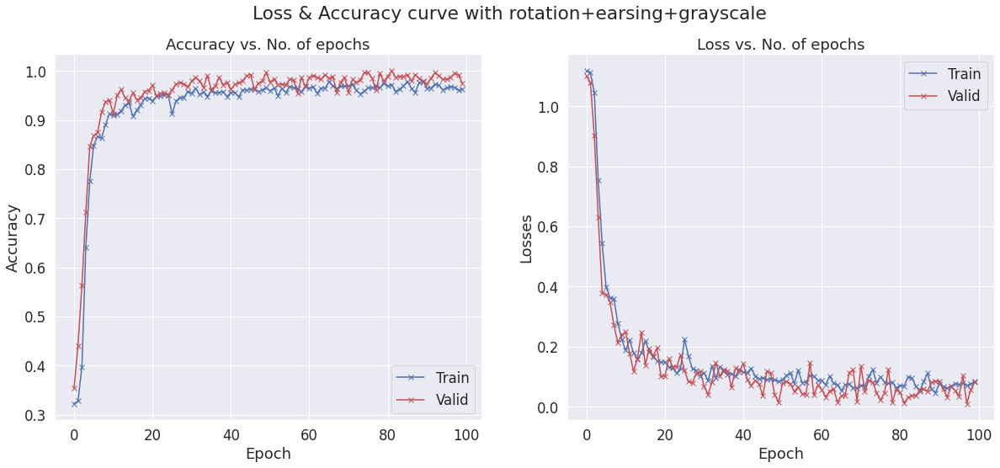

In [ ]:
history_rotation_erasing_graysclae = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_rotation_erasing_graysclae, "rotation+earsing+grayscale")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1054, val_loss: 1.1080, train_acc: 0.3490, val_acc: 0.3141


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0956, val_loss: 1.1058, train_acc: 0.3772, val_acc: 0.3141


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 1.0773, val_loss: 1.0147, train_acc: 0.3511, val_acc: 0.3441


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.8965, val_loss: 0.7476, train_acc: 0.5305, val_acc: 0.6687


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.6595, val_loss: 0.5835, train_acc: 0.7197, val_acc: 0.7845


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.6943, val_loss: 0.6194, train_acc: 0.7242, val_acc: 0.7845


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.5299, val_loss: 0.4117, train_acc: 0.7905, val_acc: 0.8509


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.4114, val_loss: 0.2994, train_acc: 0.8441, val_acc: 0.8953


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.3822, val_loss: 0.3126, train_acc: 0.8579, val_acc: 0.9015


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.3568, val_loss: 0.3510, train_acc: 0.8695, val_acc: 0.8898


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.3058, val_loss: 0.1986, train_acc: 0.8897, val_acc: 0.9410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.2719, val_loss: 0.2728, train_acc: 0.8950, val_acc: 0.8970


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.2599, val_loss: 0.1862, train_acc: 0.9042, val_acc: 0.9488


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.2227, val_loss: 0.2164, train_acc: 0.9016, val_acc: 0.9471


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.2317, val_loss: 0.1705, train_acc: 0.9244, val_acc: 0.9393


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.1756, val_loss: 0.1575, train_acc: 0.9400, val_acc: 0.9521


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1831, val_loss: 0.1114, train_acc: 0.9211, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1570, val_loss: 0.1768, train_acc: 0.9361, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.1441, val_loss: 0.0850, train_acc: 0.9307, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1511, val_loss: 0.1642, train_acc: 0.9321, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1455, val_loss: 0.1886, train_acc: 0.9380, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1409, val_loss: 0.1358, train_acc: 0.9399, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1486, val_loss: 0.1620, train_acc: 0.9466, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1295, val_loss: 0.1089, train_acc: 0.9589, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.2140, val_loss: 0.2645, train_acc: 0.9334, val_acc: 0.9521


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1191, val_loss: 0.1086, train_acc: 0.9524, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1363, val_loss: 0.1330, train_acc: 0.9465, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1138, val_loss: 0.0648, train_acc: 0.9616, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.0883, val_loss: 0.2087, train_acc: 0.9556, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1091, val_loss: 0.1275, train_acc: 0.9517, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.0709, val_loss: 0.1297, train_acc: 0.9687, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.1552, val_loss: 0.0807, train_acc: 0.9492, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.1171, val_loss: 0.1487, train_acc: 0.9609, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0951, val_loss: 0.1078, train_acc: 0.9615, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0983, val_loss: 0.0666, train_acc: 0.9681, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.0691, val_loss: 0.0407, train_acc: 0.9667, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0726, val_loss: 0.0704, train_acc: 0.9680, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0726, val_loss: 0.1180, train_acc: 0.9635, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.1045, val_loss: 0.1080, train_acc: 0.9668, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.1068, val_loss: 0.1555, train_acc: 0.9588, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.1092, val_loss: 0.0797, train_acc: 0.9583, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.0901, val_loss: 0.1171, train_acc: 0.9700, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0788, val_loss: 0.0819, train_acc: 0.9661, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0719, val_loss: 0.2036, train_acc: 0.9693, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0856, val_loss: 0.1305, train_acc: 0.9648, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0798, val_loss: 0.0603, train_acc: 0.9713, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0753, val_loss: 0.0558, train_acc: 0.9687, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0592, val_loss: 0.0410, train_acc: 0.9732, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0666, val_loss: 0.0995, train_acc: 0.9753, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0659, val_loss: 0.0505, train_acc: 0.9758, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0599, val_loss: 0.0948, train_acc: 0.9759, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0381, val_loss: 0.1059, train_acc: 0.9792, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0587, val_loss: 0.0862, train_acc: 0.9752, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0594, val_loss: 0.1649, train_acc: 0.9771, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0591, val_loss: 0.1148, train_acc: 0.9739, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0593, val_loss: 0.1671, train_acc: 0.9738, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0597, val_loss: 0.2028, train_acc: 0.9758, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0619, val_loss: 0.0257, train_acc: 0.9713, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0507, val_loss: 0.0700, train_acc: 0.9772, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0349, val_loss: 0.1045, train_acc: 0.9811, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0298, val_loss: 0.2067, train_acc: 0.9811, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0362, val_loss: 0.1323, train_acc: 0.9811, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.1260, val_loss: 0.1179, train_acc: 0.9543, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0850, val_loss: 0.0418, train_acc: 0.9680, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0716, val_loss: 0.0694, train_acc: 0.9681, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0557, val_loss: 0.1813, train_acc: 0.9732, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0542, val_loss: 0.1253, train_acc: 0.9792, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0482, val_loss: 0.0613, train_acc: 0.9797, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0556, val_loss: 0.0955, train_acc: 0.9687, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0409, val_loss: 0.0879, train_acc: 0.9805, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0332, val_loss: 0.0728, train_acc: 0.9830, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0291, val_loss: 0.1101, train_acc: 0.9817, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0307, val_loss: 0.1389, train_acc: 0.9850, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0629, val_loss: 0.0620, train_acc: 0.9727, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0478, val_loss: 0.2699, train_acc: 0.9752, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0473, val_loss: 0.0757, train_acc: 0.9739, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0386, val_loss: 0.1036, train_acc: 0.9745, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0326, val_loss: 0.1739, train_acc: 0.9837, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.1022, val_loss: 0.0804, train_acc: 0.9745, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0433, val_loss: 0.1152, train_acc: 0.9824, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0385, val_loss: 0.0632, train_acc: 0.9817, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0367, val_loss: 0.1103, train_acc: 0.9758, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0470, val_loss: 0.0596, train_acc: 0.9765, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0358, val_loss: 0.0478, train_acc: 0.9804, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0561, val_loss: 0.1368, train_acc: 0.9758, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0375, val_loss: 0.0464, train_acc: 0.9811, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0400, val_loss: 0.0294, train_acc: 0.9785, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0488, val_loss: 0.0437, train_acc: 0.9746, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0354, val_loss: 0.0394, train_acc: 0.9824, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0249, val_loss: 0.0998, train_acc: 0.9811, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0269, val_loss: 0.0656, train_acc: 0.9816, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0220, val_loss: 0.1008, train_acc: 0.9863, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0367, val_loss: 0.1026, train_acc: 0.9831, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0835, val_loss: 0.0797, train_acc: 0.9752, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0520, val_loss: 0.0542, train_acc: 0.9778, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0318, val_loss: 0.0523, train_acc: 0.9772, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0325, val_loss: 0.0167, train_acc: 0.9772, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0301, val_loss: 0.0400, train_acc: 0.9804, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0313, val_loss: 0.0244, train_acc: 0.9817, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0282, val_loss: 0.0261, train_acc: 0.9817, val_acc: 0.9850


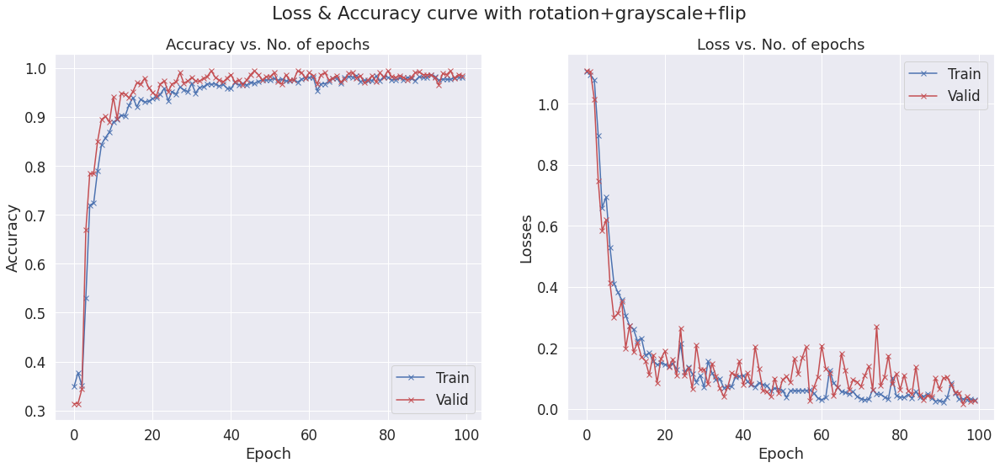

In [ ]:
history_rotation_grayscale_flip = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_rotation_grayscale_flip, "rotation+grayscale+flip")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1078, val_loss: 1.0980, train_acc: 0.3268, val_acc: 0.3357


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0898, val_loss: 1.1068, train_acc: 0.3828, val_acc: 0.3301


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 1.0736, val_loss: 0.9298, train_acc: 0.3733, val_acc: 0.5312


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.8503, val_loss: 0.7600, train_acc: 0.5787, val_acc: 0.6771


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.7330, val_loss: 0.6620, train_acc: 0.6636, val_acc: 0.6787


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.5697, val_loss: 0.5003, train_acc: 0.7698, val_acc: 0.8141


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.4331, val_loss: 0.3552, train_acc: 0.8396, val_acc: 0.8692


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.3649, val_loss: 0.4178, train_acc: 0.8617, val_acc: 0.8675


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.3091, val_loss: 0.3247, train_acc: 0.8715, val_acc: 0.8764


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2627, val_loss: 0.4474, train_acc: 0.8919, val_acc: 0.8480


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.2853, val_loss: 0.2202, train_acc: 0.8833, val_acc: 0.9243


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.2306, val_loss: 0.2299, train_acc: 0.9055, val_acc: 0.9299


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1820, val_loss: 0.1553, train_acc: 0.9166, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1772, val_loss: 0.3633, train_acc: 0.9289, val_acc: 0.9276


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1428, val_loss: 0.2096, train_acc: 0.9354, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.1539, val_loss: 0.1866, train_acc: 0.9387, val_acc: 0.9488


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1789, val_loss: 0.2153, train_acc: 0.9380, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1491, val_loss: 0.1563, train_acc: 0.9387, val_acc: 0.9560


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.1442, val_loss: 0.1924, train_acc: 0.9439, val_acc: 0.9393


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1387, val_loss: 0.0951, train_acc: 0.9413, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1115, val_loss: 0.1036, train_acc: 0.9479, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.0995, val_loss: 0.2296, train_acc: 0.9628, val_acc: 0.9494


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1093, val_loss: 0.1613, train_acc: 0.9479, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1225, val_loss: 0.0937, train_acc: 0.9453, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.0892, val_loss: 0.1241, train_acc: 0.9602, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1307, val_loss: 0.1982, train_acc: 0.9445, val_acc: 0.9416


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1377, val_loss: 0.0624, train_acc: 0.9387, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1320, val_loss: 0.1402, train_acc: 0.9471, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1169, val_loss: 0.1589, train_acc: 0.9524, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1033, val_loss: 0.1638, train_acc: 0.9524, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.0849, val_loss: 0.1100, train_acc: 0.9582, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.0771, val_loss: 0.1621, train_acc: 0.9627, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.1390, val_loss: 0.1993, train_acc: 0.9472, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.1147, val_loss: 0.0950, train_acc: 0.9511, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0801, val_loss: 0.0545, train_acc: 0.9615, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.0786, val_loss: 0.0426, train_acc: 0.9687, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0954, val_loss: 0.0696, train_acc: 0.9517, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.1006, val_loss: 0.2177, train_acc: 0.9570, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.0949, val_loss: 0.0821, train_acc: 0.9616, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.0895, val_loss: 0.0498, train_acc: 0.9543, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.1060, val_loss: 0.0692, train_acc: 0.9621, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.1016, val_loss: 0.0622, train_acc: 0.9701, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0888, val_loss: 0.0475, train_acc: 0.9706, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0958, val_loss: 0.0820, train_acc: 0.9602, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0868, val_loss: 0.0498, train_acc: 0.9674, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0679, val_loss: 0.0272, train_acc: 0.9752, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0798, val_loss: 0.1056, train_acc: 0.9713, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0889, val_loss: 0.1287, train_acc: 0.9654, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0866, val_loss: 0.1066, train_acc: 0.9713, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0615, val_loss: 0.0506, train_acc: 0.9778, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0792, val_loss: 0.0716, train_acc: 0.9752, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0725, val_loss: 0.0749, train_acc: 0.9758, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0819, val_loss: 0.1047, train_acc: 0.9726, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0776, val_loss: 0.0326, train_acc: 0.9746, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0586, val_loss: 0.0683, train_acc: 0.9791, val_acc: 0.9805


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0704, val_loss: 0.0724, train_acc: 0.9778, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0752, val_loss: 0.0700, train_acc: 0.9778, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0521, val_loss: 0.0366, train_acc: 0.9830, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0768, val_loss: 0.0476, train_acc: 0.9759, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0888, val_loss: 0.0369, train_acc: 0.9713, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0659, val_loss: 0.0879, train_acc: 0.9798, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0614, val_loss: 0.0402, train_acc: 0.9811, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0712, val_loss: 0.0598, train_acc: 0.9772, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0707, val_loss: 0.0315, train_acc: 0.9791, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0742, val_loss: 0.0434, train_acc: 0.9745, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0729, val_loss: 0.0748, train_acc: 0.9778, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.1025, val_loss: 0.0398, train_acc: 0.9720, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0827, val_loss: 0.1553, train_acc: 0.9700, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0691, val_loss: 0.0866, train_acc: 0.9759, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.1005, val_loss: 0.1350, train_acc: 0.9667, val_acc: 0.9488


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0738, val_loss: 0.0994, train_acc: 0.9778, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.1099, val_loss: 0.1536, train_acc: 0.9752, val_acc: 0.9393


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.1142, val_loss: 0.1230, train_acc: 0.9640, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0889, val_loss: 0.1000, train_acc: 0.9733, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0642, val_loss: 0.0978, train_acc: 0.9804, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.1071, val_loss: 0.0537, train_acc: 0.9693, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0655, val_loss: 0.0389, train_acc: 0.9804, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0524, val_loss: 0.1328, train_acc: 0.9856, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0617, val_loss: 0.0565, train_acc: 0.9791, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0545, val_loss: 0.1078, train_acc: 0.9883, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.1063, val_loss: 0.1542, train_acc: 0.9713, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.1014, val_loss: 0.0484, train_acc: 0.9700, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0700, val_loss: 0.1076, train_acc: 0.9798, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0689, val_loss: 0.0738, train_acc: 0.9810, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0631, val_loss: 0.0613, train_acc: 0.9785, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0595, val_loss: 0.0237, train_acc: 0.9791, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0730, val_loss: 0.0524, train_acc: 0.9751, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0568, val_loss: 0.0294, train_acc: 0.9817, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0601, val_loss: 0.0270, train_acc: 0.9811, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0668, val_loss: 0.0135, train_acc: 0.9785, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0576, val_loss: 0.0137, train_acc: 0.9831, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0424, val_loss: 0.0517, train_acc: 0.9909, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0532, val_loss: 0.0398, train_acc: 0.9817, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0499, val_loss: 0.0842, train_acc: 0.9850, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0745, val_loss: 0.0391, train_acc: 0.9745, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0517, val_loss: 0.0362, train_acc: 0.9843, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0472, val_loss: 0.0804, train_acc: 0.9830, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0593, val_loss: 0.2896, train_acc: 0.9843, val_acc: 0.9482


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.1134, val_loss: 0.0304, train_acc: 0.9654, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0537, val_loss: 0.0383, train_acc: 0.9811, val_acc: 0.9811


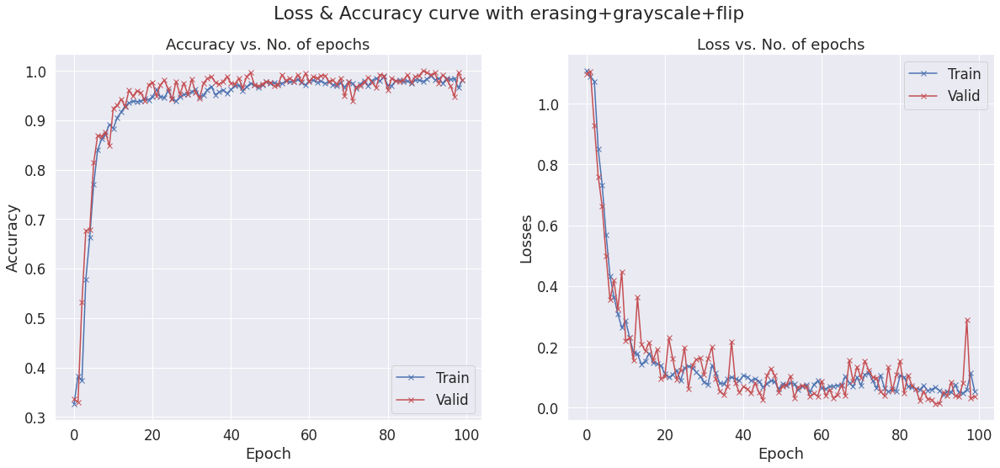

In [ ]:
history_erasing_grayscale_flip = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_erasing_grayscale_flip, "erasing+grayscale+flip")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1021, val_loss: 1.1006, train_acc: 0.3464, val_acc: 0.3318


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0907, val_loss: 1.0739, train_acc: 0.3582, val_acc: 0.4560


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.9476, val_loss: 0.8328, train_acc: 0.5481, val_acc: 0.6621


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.7129, val_loss: 0.5631, train_acc: 0.6849, val_acc: 0.7962


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.5650, val_loss: 0.4166, train_acc: 0.7913, val_acc: 0.8608


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.4393, val_loss: 0.3582, train_acc: 0.8286, val_acc: 0.8719


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.3936, val_loss: 0.4452, train_acc: 0.8579, val_acc: 0.8385


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.3466, val_loss: 0.3977, train_acc: 0.8681, val_acc: 0.8490


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.2931, val_loss: 0.2475, train_acc: 0.8995, val_acc: 0.9338


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2861, val_loss: 0.2388, train_acc: 0.9034, val_acc: 0.9220


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.2538, val_loss: 0.2419, train_acc: 0.9282, val_acc: 0.9293


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.2005, val_loss: 0.2773, train_acc: 0.9348, val_acc: 0.9165


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.2598, val_loss: 0.1527, train_acc: 0.9152, val_acc: 0.9560


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.2144, val_loss: 0.2755, train_acc: 0.9224, val_acc: 0.9109


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1978, val_loss: 0.2444, train_acc: 0.9340, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.1736, val_loss: 0.1818, train_acc: 0.9459, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.2153, val_loss: 0.2460, train_acc: 0.9270, val_acc: 0.9204


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1928, val_loss: 0.1780, train_acc: 0.9419, val_acc: 0.9260


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.1515, val_loss: 0.2293, train_acc: 0.9485, val_acc: 0.9103


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1807, val_loss: 0.1470, train_acc: 0.9354, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1462, val_loss: 0.2171, train_acc: 0.9596, val_acc: 0.9371


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1438, val_loss: 0.1072, train_acc: 0.9537, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1305, val_loss: 0.1067, train_acc: 0.9556, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1558, val_loss: 0.1155, train_acc: 0.9531, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.2709, val_loss: 0.1785, train_acc: 0.9152, val_acc: 0.9220


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1555, val_loss: 0.1588, train_acc: 0.9491, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1323, val_loss: 0.2998, train_acc: 0.9581, val_acc: 0.9064


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1778, val_loss: 0.2964, train_acc: 0.9419, val_acc: 0.9031


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1968, val_loss: 0.1864, train_acc: 0.9204, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.0994, val_loss: 0.1063, train_acc: 0.9718, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.1056, val_loss: 0.0677, train_acc: 0.9700, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.1078, val_loss: 0.0637, train_acc: 0.9647, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.0858, val_loss: 0.0981, train_acc: 0.9661, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.1197, val_loss: 0.0657, train_acc: 0.9661, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0861, val_loss: 0.0330, train_acc: 0.9655, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1163, val_loss: 0.0495, train_acc: 0.9583, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.1096, val_loss: 0.0484, train_acc: 0.9563, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0821, val_loss: 0.0401, train_acc: 0.9687, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.1123, val_loss: 0.0956, train_acc: 0.9570, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.0993, val_loss: 0.0565, train_acc: 0.9681, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0729, val_loss: 0.0379, train_acc: 0.9726, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.0862, val_loss: 0.0832, train_acc: 0.9654, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0867, val_loss: 0.0556, train_acc: 0.9654, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0630, val_loss: 0.0844, train_acc: 0.9777, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0917, val_loss: 0.1098, train_acc: 0.9628, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0833, val_loss: 0.0606, train_acc: 0.9720, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0711, val_loss: 0.0088, train_acc: 0.9726, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0730, val_loss: 0.0905, train_acc: 0.9694, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0779, val_loss: 0.1464, train_acc: 0.9745, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.1039, val_loss: 0.0639, train_acc: 0.9642, val_acc: 0.9683


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0659, val_loss: 0.0992, train_acc: 0.9792, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0831, val_loss: 0.0329, train_acc: 0.9739, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0602, val_loss: 0.0429, train_acc: 0.9745, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0740, val_loss: 0.1585, train_acc: 0.9752, val_acc: 0.9426


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0964, val_loss: 0.1811, train_acc: 0.9655, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0744, val_loss: 0.0723, train_acc: 0.9700, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0746, val_loss: 0.0529, train_acc: 0.9700, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0680, val_loss: 0.0912, train_acc: 0.9785, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0958, val_loss: 0.0584, train_acc: 0.9707, val_acc: 0.9667


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.1198, val_loss: 0.1972, train_acc: 0.9647, val_acc: 0.9293


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0907, val_loss: 0.1247, train_acc: 0.9674, val_acc: 0.9465


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.1095, val_loss: 0.0673, train_acc: 0.9640, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0903, val_loss: 0.0425, train_acc: 0.9674, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0819, val_loss: 0.0784, train_acc: 0.9726, val_acc: 0.9805


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0677, val_loss: 0.0962, train_acc: 0.9798, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.1149, val_loss: 0.0614, train_acc: 0.9668, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0757, val_loss: 0.0994, train_acc: 0.9745, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0713, val_loss: 0.0953, train_acc: 0.9712, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.1312, val_loss: 0.0247, train_acc: 0.9635, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0872, val_loss: 0.1643, train_acc: 0.9694, val_acc: 0.9426


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.1411, val_loss: 0.0832, train_acc: 0.9531, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.1014, val_loss: 0.0577, train_acc: 0.9641, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0934, val_loss: 0.1160, train_acc: 0.9713, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.1000, val_loss: 0.0893, train_acc: 0.9687, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0656, val_loss: 0.0430, train_acc: 0.9739, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0605, val_loss: 0.0764, train_acc: 0.9785, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0590, val_loss: 0.0408, train_acc: 0.9759, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0874, val_loss: 0.1402, train_acc: 0.9746, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0616, val_loss: 0.0260, train_acc: 0.9752, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0717, val_loss: 0.0461, train_acc: 0.9772, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0712, val_loss: 0.0293, train_acc: 0.9700, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0611, val_loss: 0.0722, train_acc: 0.9798, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0804, val_loss: 0.0203, train_acc: 0.9700, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0546, val_loss: 0.0349, train_acc: 0.9798, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0583, val_loss: 0.0176, train_acc: 0.9772, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0591, val_loss: 0.0455, train_acc: 0.9764, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0476, val_loss: 0.0199, train_acc: 0.9817, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0578, val_loss: 0.0375, train_acc: 0.9824, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0661, val_loss: 0.0752, train_acc: 0.9706, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0845, val_loss: 0.0585, train_acc: 0.9726, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0565, val_loss: 0.0648, train_acc: 0.9785, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0511, val_loss: 0.0657, train_acc: 0.9798, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0751, val_loss: 0.0171, train_acc: 0.9758, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0658, val_loss: 0.0258, train_acc: 0.9746, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0837, val_loss: 0.0527, train_acc: 0.9732, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0601, val_loss: 0.1412, train_acc: 0.9785, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0733, val_loss: 0.1030, train_acc: 0.9706, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0630, val_loss: 0.0254, train_acc: 0.9785, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0737, val_loss: 0.0133, train_acc: 0.9778, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0493, val_loss: 0.0287, train_acc: 0.9830, val_acc: 0.9905


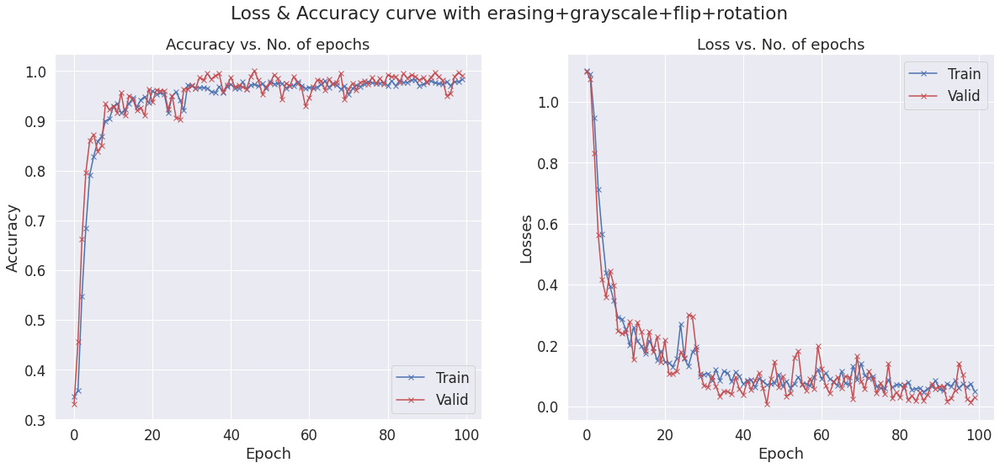

In [ ]:
history_rotation_grayscale_flip_erasing = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_rotation_grayscale_flip_erasing, "erasing+grayscale+flip+rotation")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1019, val_loss: 1.0953, train_acc: 0.3444, val_acc: 0.3542


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0164, val_loss: 0.9017, train_acc: 0.4444, val_acc: 0.5596


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.8499, val_loss: 0.8140, train_acc: 0.5721, val_acc: 0.5730


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.7256, val_loss: 0.6583, train_acc: 0.6059, val_acc: 0.6096


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.6803, val_loss: 0.6997, train_acc: 0.6314, val_acc: 0.6536


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.6507, val_loss: 0.6055, train_acc: 0.6556, val_acc: 0.6502


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.6444, val_loss: 0.6286, train_acc: 0.6720, val_acc: 0.7583


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.5996, val_loss: 0.6617, train_acc: 0.6811, val_acc: 0.7149


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.5024, val_loss: 0.4622, train_acc: 0.7888, val_acc: 0.8813


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.5242, val_loss: 0.5483, train_acc: 0.8074, val_acc: 0.7172


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.4797, val_loss: 0.3278, train_acc: 0.8227, val_acc: 0.8803


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.3859, val_loss: 0.2937, train_acc: 0.8578, val_acc: 0.8931


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.3071, val_loss: 0.1962, train_acc: 0.8866, val_acc: 0.9326


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.2581, val_loss: 0.2352, train_acc: 0.9022, val_acc: 0.9299


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.2544, val_loss: 0.2075, train_acc: 0.8983, val_acc: 0.9309


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.2337, val_loss: 0.2794, train_acc: 0.9101, val_acc: 0.9109


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.2328, val_loss: 0.1605, train_acc: 0.9049, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1978, val_loss: 0.0761, train_acc: 0.9322, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.2031, val_loss: 0.1512, train_acc: 0.9334, val_acc: 0.9360


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1702, val_loss: 0.1040, train_acc: 0.9373, val_acc: 0.9615


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1363, val_loss: 0.1330, train_acc: 0.9531, val_acc: 0.9416


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1584, val_loss: 0.1849, train_acc: 0.9426, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.2281, val_loss: 0.1406, train_acc: 0.9237, val_acc: 0.9549


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1582, val_loss: 0.1227, train_acc: 0.9439, val_acc: 0.9510


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.1643, val_loss: 0.1324, train_acc: 0.9399, val_acc: 0.9644


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1111, val_loss: 0.1889, train_acc: 0.9582, val_acc: 0.9465


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1398, val_loss: 0.1298, train_acc: 0.9505, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1486, val_loss: 0.1439, train_acc: 0.9439, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.1392, val_loss: 0.1911, train_acc: 0.9439, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1241, val_loss: 0.1707, train_acc: 0.9490, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.0867, val_loss: 0.0897, train_acc: 0.9726, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.1580, val_loss: 0.0891, train_acc: 0.9471, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.0993, val_loss: 0.0737, train_acc: 0.9641, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.1155, val_loss: 0.1744, train_acc: 0.9550, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.1238, val_loss: 0.0780, train_acc: 0.9556, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.1076, val_loss: 0.1118, train_acc: 0.9609, val_acc: 0.9443


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.1100, val_loss: 0.0646, train_acc: 0.9562, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.1190, val_loss: 0.0935, train_acc: 0.9628, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.0962, val_loss: 0.1112, train_acc: 0.9648, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.1059, val_loss: 0.0500, train_acc: 0.9594, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0987, val_loss: 0.1167, train_acc: 0.9621, val_acc: 0.9599


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.0942, val_loss: 0.0971, train_acc: 0.9667, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.1022, val_loss: 0.1212, train_acc: 0.9648, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.1380, val_loss: 0.1645, train_acc: 0.9511, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.1175, val_loss: 0.0959, train_acc: 0.9595, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.1104, val_loss: 0.0623, train_acc: 0.9603, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.1163, val_loss: 0.1827, train_acc: 0.9543, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.1348, val_loss: 0.0544, train_acc: 0.9544, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.1059, val_loss: 0.0419, train_acc: 0.9577, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.1129, val_loss: 0.1034, train_acc: 0.9622, val_acc: 0.9521


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0961, val_loss: 0.1065, train_acc: 0.9589, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.1025, val_loss: 0.0839, train_acc: 0.9576, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.1201, val_loss: 0.1554, train_acc: 0.9577, val_acc: 0.9315


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0973, val_loss: 0.0942, train_acc: 0.9635, val_acc: 0.9589


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0998, val_loss: 0.0563, train_acc: 0.9672, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0997, val_loss: 0.0943, train_acc: 0.9615, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0977, val_loss: 0.0329, train_acc: 0.9556, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.1552, val_loss: 0.1488, train_acc: 0.9498, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.1051, val_loss: 0.1776, train_acc: 0.9536, val_acc: 0.9644


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0875, val_loss: 0.0485, train_acc: 0.9699, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.1091, val_loss: 0.1373, train_acc: 0.9628, val_acc: 0.9338


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0738, val_loss: 0.0601, train_acc: 0.9727, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0989, val_loss: 0.0802, train_acc: 0.9647, val_acc: 0.9655


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0735, val_loss: 0.0805, train_acc: 0.9719, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0999, val_loss: 0.0731, train_acc: 0.9602, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0828, val_loss: 0.0487, train_acc: 0.9635, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0625, val_loss: 0.1643, train_acc: 0.9746, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.1038, val_loss: 0.1073, train_acc: 0.9641, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.2002, val_loss: 0.0985, train_acc: 0.9374, val_acc: 0.9560


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0873, val_loss: 0.1168, train_acc: 0.9648, val_acc: 0.9549


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0987, val_loss: 0.2215, train_acc: 0.9590, val_acc: 0.9465


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.1030, val_loss: 0.0690, train_acc: 0.9551, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0750, val_loss: 0.0704, train_acc: 0.9726, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0828, val_loss: 0.0528, train_acc: 0.9739, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.1001, val_loss: 0.1036, train_acc: 0.9504, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0853, val_loss: 0.0664, train_acc: 0.9602, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0863, val_loss: 0.0759, train_acc: 0.9659, val_acc: 0.9644


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0703, val_loss: 0.0317, train_acc: 0.9771, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0913, val_loss: 0.0492, train_acc: 0.9596, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.1297, val_loss: 0.1953, train_acc: 0.9583, val_acc: 0.9488


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.1156, val_loss: 0.0295, train_acc: 0.9537, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0920, val_loss: 0.0879, train_acc: 0.9590, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0610, val_loss: 0.0237, train_acc: 0.9726, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0652, val_loss: 0.1843, train_acc: 0.9681, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0712, val_loss: 0.0503, train_acc: 0.9674, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0537, val_loss: 0.0470, train_acc: 0.9758, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0670, val_loss: 0.0800, train_acc: 0.9732, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0797, val_loss: 0.0419, train_acc: 0.9673, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0821, val_loss: 0.0243, train_acc: 0.9694, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0613, val_loss: 0.0402, train_acc: 0.9753, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.1439, val_loss: 0.1527, train_acc: 0.9516, val_acc: 0.9354


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.1175, val_loss: 0.0707, train_acc: 0.9629, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0781, val_loss: 0.0760, train_acc: 0.9726, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0610, val_loss: 0.1375, train_acc: 0.9739, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0826, val_loss: 0.0558, train_acc: 0.9687, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0705, val_loss: 0.0283, train_acc: 0.9700, val_acc: 0.9922


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0817, val_loss: 0.0411, train_acc: 0.9674, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0473, val_loss: 0.0034, train_acc: 0.9824, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0738, val_loss: 0.0980, train_acc: 0.9674, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0772, val_loss: 0.0365, train_acc: 0.9739, val_acc: 0.9905


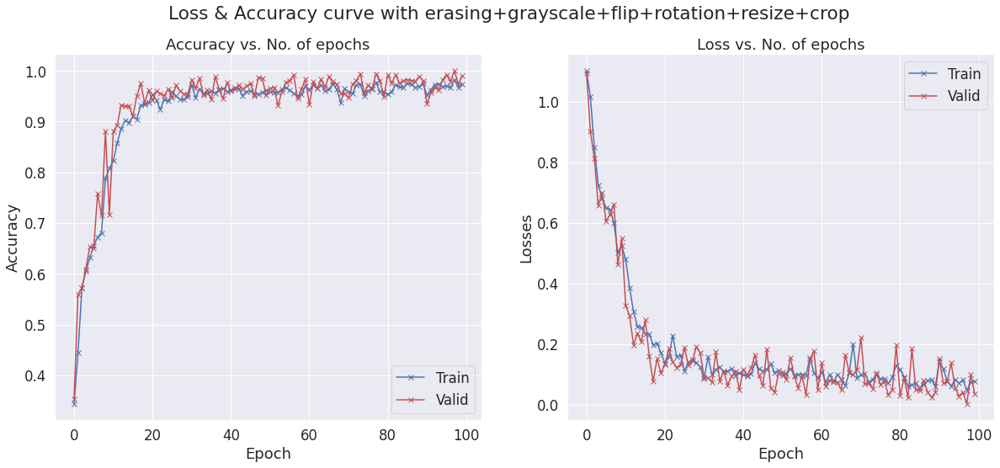

In [ ]:
history_rotation_grayscale_flip_erasing_resize_crop = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_rotation_grayscale_flip_erasing_resize_crop, "erasing+grayscale+flip+rotation+resize+crop")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.1175, val_loss: 1.0991, train_acc: 0.3229, val_acc: 0.3542


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.1070, val_loss: 1.0915, train_acc: 0.3217, val_acc: 0.3542


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 1.0449, val_loss: 0.9253, train_acc: 0.3219, val_acc: 0.3690


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.8561, val_loss: 0.7247, train_acc: 0.5046, val_acc: 0.6286


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.6883, val_loss: 0.6380, train_acc: 0.6480, val_acc: 0.8223


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.5673, val_loss: 0.6960, train_acc: 0.7657, val_acc: 0.8122


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.5216, val_loss: 0.4359, train_acc: 0.8051, val_acc: 0.8914


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.3664, val_loss: 0.3165, train_acc: 0.8703, val_acc: 0.9142


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.3189, val_loss: 0.2956, train_acc: 0.8872, val_acc: 0.8708


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2653, val_loss: 0.4111, train_acc: 0.9183, val_acc: 0.8575


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.2669, val_loss: 0.3509, train_acc: 0.9119, val_acc: 0.9015


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.2536, val_loss: 0.2256, train_acc: 0.9190, val_acc: 0.9165


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.1854, val_loss: 0.1492, train_acc: 0.9302, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.1740, val_loss: 0.2247, train_acc: 0.9373, val_acc: 0.9132


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1947, val_loss: 0.1750, train_acc: 0.9399, val_acc: 0.9471


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.1643, val_loss: 0.1549, train_acc: 0.9367, val_acc: 0.9504


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.1002, val_loss: 0.1692, train_acc: 0.9693, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1271, val_loss: 0.0731, train_acc: 0.9583, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.1247, val_loss: 0.0640, train_acc: 0.9590, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1146, val_loss: 0.0926, train_acc: 0.9465, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1339, val_loss: 0.0731, train_acc: 0.9504, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.0980, val_loss: 0.1556, train_acc: 0.9628, val_acc: 0.9410


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1127, val_loss: 0.1399, train_acc: 0.9518, val_acc: 0.9510


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.1218, val_loss: 0.2365, train_acc: 0.9575, val_acc: 0.9048


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.1308, val_loss: 0.0713, train_acc: 0.9518, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1054, val_loss: 0.2378, train_acc: 0.9590, val_acc: 0.9566


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.0974, val_loss: 0.1356, train_acc: 0.9679, val_acc: 0.9510


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1120, val_loss: 0.1993, train_acc: 0.9622, val_acc: 0.9449


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.0854, val_loss: 0.0799, train_acc: 0.9641, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.1081, val_loss: 0.1316, train_acc: 0.9674, val_acc: 0.9582


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.1007, val_loss: 0.0707, train_acc: 0.9648, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.0636, val_loss: 0.0923, train_acc: 0.9713, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.1055, val_loss: 0.1579, train_acc: 0.9640, val_acc: 0.9432


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0896, val_loss: 0.0741, train_acc: 0.9596, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0752, val_loss: 0.0641, train_acc: 0.9700, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.0761, val_loss: 0.0813, train_acc: 0.9660, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0942, val_loss: 0.1021, train_acc: 0.9733, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0887, val_loss: 0.0530, train_acc: 0.9635, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.0832, val_loss: 0.0694, train_acc: 0.9668, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.0995, val_loss: 0.0501, train_acc: 0.9642, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.0682, val_loss: 0.1338, train_acc: 0.9752, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.1022, val_loss: 0.0908, train_acc: 0.9609, val_acc: 0.9710


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0749, val_loss: 0.0754, train_acc: 0.9680, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0922, val_loss: 0.1579, train_acc: 0.9668, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.0744, val_loss: 0.1937, train_acc: 0.9680, val_acc: 0.9521


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0683, val_loss: 0.0604, train_acc: 0.9739, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0723, val_loss: 0.1736, train_acc: 0.9732, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.0620, val_loss: 0.0647, train_acc: 0.9727, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.0602, val_loss: 0.0705, train_acc: 0.9712, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.0861, val_loss: 0.0365, train_acc: 0.9687, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.0858, val_loss: 0.0608, train_acc: 0.9700, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0475, val_loss: 0.0408, train_acc: 0.9791, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0704, val_loss: 0.0276, train_acc: 0.9713, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.0956, val_loss: 0.0907, train_acc: 0.9661, val_acc: 0.9683


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0730, val_loss: 0.0508, train_acc: 0.9687, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0692, val_loss: 0.0154, train_acc: 0.9765, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0586, val_loss: 0.0576, train_acc: 0.9771, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0474, val_loss: 0.1511, train_acc: 0.9817, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.0481, val_loss: 0.0628, train_acc: 0.9804, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.0779, val_loss: 0.0430, train_acc: 0.9668, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0655, val_loss: 0.0596, train_acc: 0.9714, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0512, val_loss: 0.0288, train_acc: 0.9791, val_acc: 0.9883


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0664, val_loss: 0.0667, train_acc: 0.9745, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0583, val_loss: 0.0247, train_acc: 0.9713, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0552, val_loss: 0.0813, train_acc: 0.9765, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0786, val_loss: 0.0465, train_acc: 0.9622, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0552, val_loss: 0.1452, train_acc: 0.9758, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0632, val_loss: 0.0544, train_acc: 0.9805, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0537, val_loss: 0.0748, train_acc: 0.9791, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0791, val_loss: 0.1986, train_acc: 0.9706, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0769, val_loss: 0.0544, train_acc: 0.9688, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0562, val_loss: 0.1004, train_acc: 0.9732, val_acc: 0.9644


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0611, val_loss: 0.0359, train_acc: 0.9713, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0449, val_loss: 0.0835, train_acc: 0.9817, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0673, val_loss: 0.1465, train_acc: 0.9733, val_acc: 0.9700


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0585, val_loss: 0.1145, train_acc: 0.9719, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0469, val_loss: 0.0497, train_acc: 0.9785, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0351, val_loss: 0.0691, train_acc: 0.9830, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0681, val_loss: 0.0765, train_acc: 0.9745, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0560, val_loss: 0.0394, train_acc: 0.9817, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0699, val_loss: 0.1126, train_acc: 0.9733, val_acc: 0.9683


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0599, val_loss: 0.0073, train_acc: 0.9746, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0444, val_loss: 0.0726, train_acc: 0.9798, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0669, val_loss: 0.0145, train_acc: 0.9726, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0513, val_loss: 0.0825, train_acc: 0.9791, val_acc: 0.9739


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0467, val_loss: 0.0243, train_acc: 0.9785, val_acc: 0.9844


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0813, val_loss: 0.0216, train_acc: 0.9687, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0583, val_loss: 0.0177, train_acc: 0.9719, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0778, val_loss: 0.0349, train_acc: 0.9824, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0783, val_loss: 0.0493, train_acc: 0.9719, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0707, val_loss: 0.0869, train_acc: 0.9726, val_acc: 0.9605


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0636, val_loss: 0.0478, train_acc: 0.9752, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0839, val_loss: 0.1868, train_acc: 0.9726, val_acc: 0.9788


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0661, val_loss: 0.0562, train_acc: 0.9693, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0497, val_loss: 0.0120, train_acc: 0.9811, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0513, val_loss: 0.0194, train_acc: 0.9798, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0511, val_loss: 0.0489, train_acc: 0.9785, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0617, val_loss: 0.0220, train_acc: 0.9772, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0541, val_loss: 0.0383, train_acc: 0.9785, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0411, val_loss: 0.0159, train_acc: 0.9850, val_acc: 0.9944


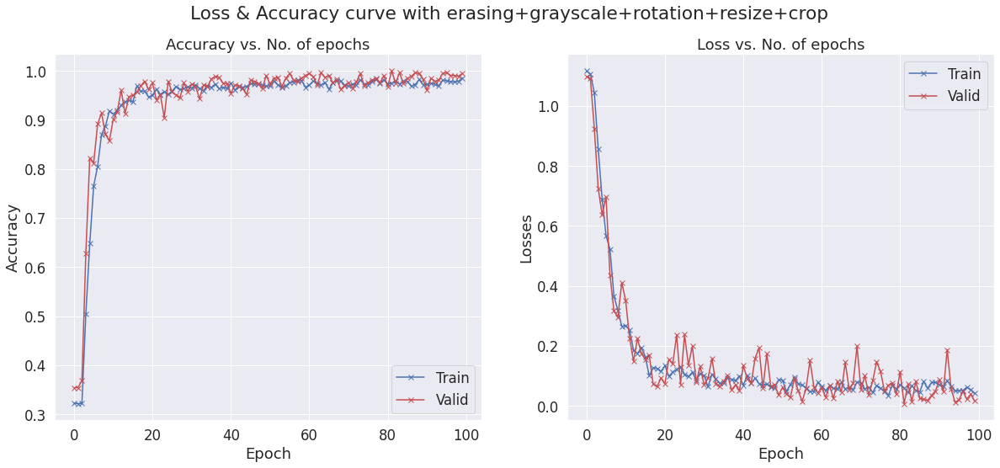

In [ ]:
history_rotation_grayscale_erasing_resize_crop = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_rotation_grayscale_erasing_resize_crop, "erasing+grayscale+rotation+resize+crop")

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [0], train_loss: 1.0987, val_loss: 1.0928, train_acc: 0.3452, val_acc: 0.4632


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [1], train_loss: 1.0771, val_loss: 1.0115, train_acc: 0.4542, val_acc: 0.6269


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [2], train_loss: 0.8873, val_loss: 0.9463, train_acc: 0.5466, val_acc: 0.5607


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [3], train_loss: 0.6241, val_loss: 0.4837, train_acc: 0.6336, val_acc: 0.7544


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [4], train_loss: 0.4747, val_loss: 0.3924, train_acc: 0.7638, val_acc: 0.8764


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [5], train_loss: 0.4005, val_loss: 0.4496, train_acc: 0.8429, val_acc: 0.8780


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [6], train_loss: 0.4059, val_loss: 0.2564, train_acc: 0.8364, val_acc: 0.9260


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [7], train_loss: 0.3406, val_loss: 0.3290, train_acc: 0.8800, val_acc: 0.9031


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [8], train_loss: 0.3398, val_loss: 0.2687, train_acc: 0.8787, val_acc: 0.9097


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [9], train_loss: 0.2938, val_loss: 0.1717, train_acc: 0.8951, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [10], train_loss: 0.2314, val_loss: 0.1827, train_acc: 0.9112, val_acc: 0.9387


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [11], train_loss: 0.2458, val_loss: 0.2434, train_acc: 0.9081, val_acc: 0.9399


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [12], train_loss: 0.2163, val_loss: 0.1330, train_acc: 0.9126, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [13], train_loss: 0.2086, val_loss: 0.1678, train_acc: 0.9159, val_acc: 0.9527


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [14], train_loss: 0.1805, val_loss: 0.1124, train_acc: 0.9382, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [15], train_loss: 0.2049, val_loss: 0.2196, train_acc: 0.9197, val_acc: 0.9549


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [16], train_loss: 0.2001, val_loss: 0.1737, train_acc: 0.9301, val_acc: 0.9465


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [17], train_loss: 0.1590, val_loss: 0.1604, train_acc: 0.9524, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [18], train_loss: 0.2081, val_loss: 0.1309, train_acc: 0.9244, val_acc: 0.9560


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [19], train_loss: 0.1444, val_loss: 0.1214, train_acc: 0.9497, val_acc: 0.9638


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [20], train_loss: 0.1630, val_loss: 0.2397, train_acc: 0.9334, val_acc: 0.9148


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [21], train_loss: 0.1382, val_loss: 0.0704, train_acc: 0.9446, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [22], train_loss: 0.1352, val_loss: 0.0638, train_acc: 0.9479, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [23], train_loss: 0.0917, val_loss: 0.0702, train_acc: 0.9570, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [24], train_loss: 0.1122, val_loss: 0.0754, train_acc: 0.9498, val_acc: 0.9622


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [25], train_loss: 0.1299, val_loss: 0.1217, train_acc: 0.9420, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [26], train_loss: 0.1026, val_loss: 0.0448, train_acc: 0.9530, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [27], train_loss: 0.1181, val_loss: 0.0729, train_acc: 0.9405, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [28], train_loss: 0.0976, val_loss: 0.1351, train_acc: 0.9458, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [29], train_loss: 0.0962, val_loss: 0.1043, train_acc: 0.9550, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [30], train_loss: 0.1223, val_loss: 0.1066, train_acc: 0.9445, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [31], train_loss: 0.1084, val_loss: 0.0831, train_acc: 0.9596, val_acc: 0.9733


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [32], train_loss: 0.0897, val_loss: 0.0470, train_acc: 0.9616, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [33], train_loss: 0.0764, val_loss: 0.0600, train_acc: 0.9622, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [34], train_loss: 0.0783, val_loss: 0.1066, train_acc: 0.9581, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [35], train_loss: 0.0678, val_loss: 0.1096, train_acc: 0.9635, val_acc: 0.9661


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [36], train_loss: 0.0733, val_loss: 0.0462, train_acc: 0.9583, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [37], train_loss: 0.0830, val_loss: 0.1574, train_acc: 0.9668, val_acc: 0.9521


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [38], train_loss: 0.1200, val_loss: 0.0503, train_acc: 0.9596, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [39], train_loss: 0.1056, val_loss: 0.0282, train_acc: 0.9661, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [40], train_loss: 0.1134, val_loss: 0.1030, train_acc: 0.9681, val_acc: 0.9772


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [41], train_loss: 0.0811, val_loss: 0.0716, train_acc: 0.9726, val_acc: 0.9716


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [42], train_loss: 0.0622, val_loss: 0.0390, train_acc: 0.9778, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [43], train_loss: 0.0584, val_loss: 0.0642, train_acc: 0.9863, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [44], train_loss: 0.1261, val_loss: 0.1491, train_acc: 0.9700, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [45], train_loss: 0.0911, val_loss: 0.0375, train_acc: 0.9804, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [46], train_loss: 0.0727, val_loss: 0.0428, train_acc: 0.9759, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [47], train_loss: 0.1220, val_loss: 0.2418, train_acc: 0.9547, val_acc: 0.9315


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [48], train_loss: 0.1001, val_loss: 1.1772, train_acc: 0.9759, val_acc: 0.9348


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [49], train_loss: 0.2275, val_loss: 0.0564, train_acc: 0.9498, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [50], train_loss: 0.1086, val_loss: 0.0820, train_acc: 0.9655, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [51], train_loss: 0.0885, val_loss: 0.0768, train_acc: 0.9765, val_acc: 0.9694


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [52], train_loss: 0.0955, val_loss: 0.1030, train_acc: 0.9733, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [53], train_loss: 0.1136, val_loss: 0.0705, train_acc: 0.9713, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [54], train_loss: 0.0657, val_loss: 0.0241, train_acc: 0.9817, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [55], train_loss: 0.0717, val_loss: 0.0601, train_acc: 0.9797, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [56], train_loss: 0.0520, val_loss: 0.0083, train_acc: 0.9837, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [57], train_loss: 0.0747, val_loss: 0.1097, train_acc: 0.9856, val_acc: 0.9749


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [58], train_loss: 0.1476, val_loss: 0.0721, train_acc: 0.9668, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [59], train_loss: 0.1063, val_loss: 0.0322, train_acc: 0.9726, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [60], train_loss: 0.0462, val_loss: 0.0451, train_acc: 0.9889, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [61], train_loss: 0.0596, val_loss: 0.0394, train_acc: 0.9837, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [62], train_loss: 0.0651, val_loss: 0.0206, train_acc: 0.9798, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [63], train_loss: 0.0542, val_loss: 0.0176, train_acc: 0.9837, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [64], train_loss: 0.0699, val_loss: 0.0735, train_acc: 0.9798, val_acc: 0.9833


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [65], train_loss: 0.0452, val_loss: 0.0249, train_acc: 0.9862, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [66], train_loss: 0.0491, val_loss: 0.0502, train_acc: 0.9857, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [67], train_loss: 0.0384, val_loss: 0.0907, train_acc: 0.9876, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [68], train_loss: 0.0805, val_loss: 0.0690, train_acc: 0.9817, val_acc: 0.9677


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [69], train_loss: 0.0846, val_loss: 0.0638, train_acc: 0.9772, val_acc: 0.9811


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [70], train_loss: 0.0514, val_loss: 0.0264, train_acc: 0.9856, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [71], train_loss: 0.0815, val_loss: 0.0470, train_acc: 0.9701, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [72], train_loss: 0.0568, val_loss: 0.0330, train_acc: 0.9843, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [73], train_loss: 0.0731, val_loss: 0.0801, train_acc: 0.9778, val_acc: 0.9755


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [74], train_loss: 0.0654, val_loss: 0.0399, train_acc: 0.9818, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [75], train_loss: 0.0601, val_loss: 0.1030, train_acc: 0.9862, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [76], train_loss: 0.0457, val_loss: 0.0249, train_acc: 0.9830, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [77], train_loss: 0.0366, val_loss: 0.0515, train_acc: 0.9869, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [78], train_loss: 0.0461, val_loss: 0.0836, train_acc: 0.9830, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [79], train_loss: 0.0478, val_loss: 0.0091, train_acc: 0.9805, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [80], train_loss: 0.0731, val_loss: 0.0389, train_acc: 0.9811, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [81], train_loss: 0.0841, val_loss: 0.0245, train_acc: 0.9752, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [82], train_loss: 0.0595, val_loss: 0.0054, train_acc: 0.9830, val_acc: 1.0000


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [83], train_loss: 0.0406, val_loss: 0.0284, train_acc: 0.9863, val_acc: 0.9905


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [84], train_loss: 0.0454, val_loss: 0.0413, train_acc: 0.9843, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [85], train_loss: 0.0788, val_loss: 0.0850, train_acc: 0.9751, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [86], train_loss: 0.0638, val_loss: 0.1112, train_acc: 0.9765, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [87], train_loss: 0.0981, val_loss: 0.1418, train_acc: 0.9798, val_acc: 0.9827


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [88], train_loss: 0.0788, val_loss: 0.0998, train_acc: 0.9804, val_acc: 0.9850


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [89], train_loss: 0.0562, val_loss: 0.0154, train_acc: 0.9856, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [90], train_loss: 0.0673, val_loss: 0.0268, train_acc: 0.9856, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [91], train_loss: 0.0553, val_loss: 0.0197, train_acc: 0.9831, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [92], train_loss: 0.0531, val_loss: 0.0291, train_acc: 0.9850, val_acc: 0.9866


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [93], train_loss: 0.0833, val_loss: 0.1808, train_acc: 0.9699, val_acc: 0.9543


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [94], train_loss: 0.0563, val_loss: 0.0632, train_acc: 0.9785, val_acc: 0.9794


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [95], train_loss: 0.0449, val_loss: 0.0405, train_acc: 0.9837, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [96], train_loss: 0.0428, val_loss: 0.1168, train_acc: 0.9882, val_acc: 0.9889


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [97], train_loss: 0.0336, val_loss: 0.0116, train_acc: 0.9883, val_acc: 0.9944


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [98], train_loss: 0.0387, val_loss: 0.0047, train_acc: 0.9857, val_acc: 0.9961


  0%|          | 0/24 [00:00<?, ?it/s]

Epoch [99], train_loss: 0.0359, val_loss: 0.0837, train_acc: 0.9869, val_acc: 0.9889


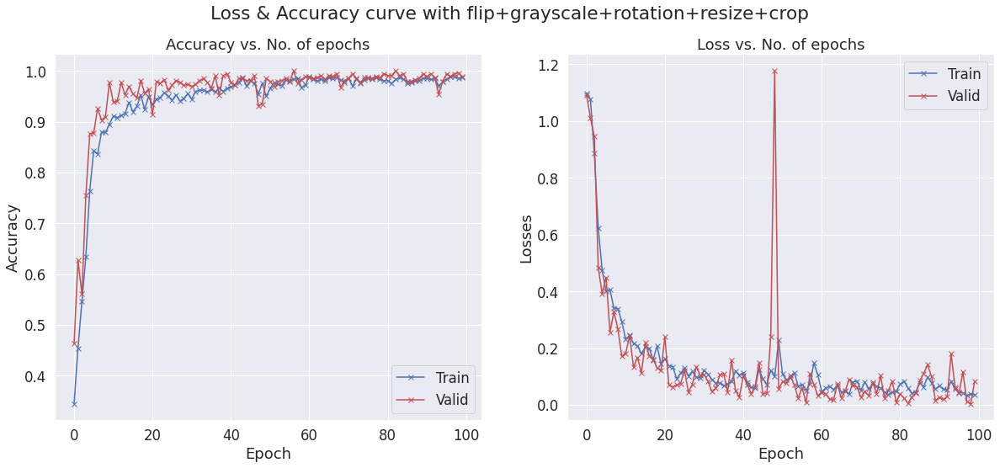

In [ ]:
history_rotation_grayscale_flip_resize_crop = fit2(num_epochs, lr, model, train_dl, val_dl, opt_func)
plot_1(history_rotation_grayscale_flip_resize_crop, "flip+grayscale+rotation+resize+crop")

In [ ]:
history_list.append(history_baseline)
history_list.append(history_rotation)
history_list.append(history_erasing)
history_list.append(history_gray)
history_list.append(history_flip)
history_list.append(history_rotation_erasing)
history_list.append(history_rotation_grayscale)
history_list.append(history_rotation_flip)
history_list.append(history_rotation_erasing_graysclae)
history_list.append(history_rotation_grayscale_flip)
history_list.append(history_erasing_grayscale_flip)
history_list.append(history_rotation_grayscale_flip_erasing)
history_list.append(history_rotation_grayscale_flip_erasing_resize_crop)

In [ ]:
def plot_accuracy_1(history): 
  plt.figure()
  sns.set(style='darkgrid')
  sns.set(font_scale=1.5)
  plt.rcParams["figure.figsize"] = (12,6)
  val_acc1 = [x['val_acc'] for x in history[0]]
  val_acc2 = [x['val_acc'] for x in history[1]]
  val_acc3 = [x['val_acc'] for x in history[2]]
  val_acc4 = [x['val_acc'] for x in history[3]]
  val_acc5 = [x['val_acc'] for x in history[4]]
  val_acc6 = [x['val_acc'] for x in history[5]]
  val_acc7 = [x['val_acc'] for x in history[6]]
  val_acc8 = [x['val_acc'] for x in history[7]]
  val_acc9 = [x['val_acc'] for x in history[8]]
  val_acc10 = [x['val_acc'] for x in history[9]]
  val_acc11 = [x['val_acc'] for x in history[10]]
  val_acc12 = [x['val_acc'] for x in history[11]]
  val_acc13 = [x['val_acc'] for x in history[12]]
  plt.plot(val_acc1,'r-o')
  plt.plot(val_acc2,'c-o')
  plt.plot(val_acc3,'m-o')
  plt.plot(val_acc4,'y-o')
  plt.plot(val_acc5,'b-o')
  plt.plot(val_acc6,'g-o')
  plt.plot(val_acc7,'k-o')
  plt.plot(val_acc8,'w-o')
  plt.plot(val_acc9,'r-o')
  plt.plot(val_acc10,'c-o')
  plt.plot(val_acc11,'m-o')
  plt.plot(val_acc12,'y-o')
  plt.plot(val_acc13,'b-o')

  plt.legend(['1','0.1','0.01','0.001'])
  plt.title('Train Accuracy for different LR')
  plt.xlabel('Epoch')
  plt.ylabel('Accuracy')


def plot_accuracy_2(history): 
  plt.figure()
  sns.set(style='darkgrid')
  sns.set(font_scale=1.5)
  plt.rcParams["figure.figsize"] = (12,6)
  val_acc1 = [x['val_acc'] for x in history[0]]
  val_acc2 = [x['val_acc'] for x in history[1]]
  val_acc3 = [x['val_acc'] for x in history[2]]
  val_acc4 = [x['val_acc'] for x in history[3]]
  val_acc5 = [x['val_acc'] for x in history[4]]
  val_acc6 = [x['val_acc'] for x in history[5]]
  val_acc7 = [x['val_acc'] for x in history[6]]
  val_acc8 = [x['val_acc'] for x in history[7]]
  val_acc9 = [x['val_acc'] for x in history[8]]
  val_acc10 = [x['val_acc'] for x in history[9]]
  val_acc11 = [x['val_acc'] for x in history[10]]
  val_acc12 = [x['val_acc'] for x in history[11]]
  val_acc13 = [x['val_acc'] for x in history[12]]
  plt.plot(val_acc1,'r-o')
  plt.plot(val_acc2,'c-o')
  plt.plot(val_acc3,'m-o')
  plt.plot(val_acc4,'y-o')
  plt.plot(val_acc5,'b-o')
  plt.plot(val_acc6,'g-o')
  plt.plot(val_acc7,'k-o')
  plt.plot(val_acc8,'w-o')
  plt.plot(val_acc9,'r-o')
  plt.plot(val_acc10,'c-o')
  plt.plot(val_acc11,'m-o')
  plt.plot(val_acc12,'y-o')
  plt.plot(val_acc13,'b-o')

  plt.legend(['1','0.1','0.01','0.001'])
  plt.title('Train Accuracy for different LR')
  plt.xlabel('Epoch')
  plt.ylabel('Accuracy') 

def plot_losses_1(loss_list): 
  plt.figure()
  sns.set(style='darkgrid')
  sns.set(font_scale=1.5)
  plt.rcParams["figure.figsize"] = (12,6)
  plt.plot(loss_list[0],'r-o')
  plt.plot(loss_list[1],'c-o')
  plt.plot(loss_list[2],'m-o')
  plt.plot(loss_list[3],'y-o')
  plt.legend(['1','0.1','0.01','0.001'])
  plt.title('Losses Curve for different LR')
  plt.xlabel('Epoch')
  plt.ylabel('Losses') 

def plot_1(history, string):
  sns.set(style='darkgrid')
  sns.set(font_scale=1.5)
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,8))
  fig.suptitle(f'Loss & Accuracy curve with {string}')

  train_acc = [x['train_acc'] for x in history]
  val_acc = [x['val_acc'] for x in history]
  ax1.plot(train_acc,'-bx')
  ax1.plot(val_acc,'-rx')
  ax1.legend(['Train','Valid'])
  ax1.set(xlabel='Epoch', ylabel='Accuracy')
  ax1.set_title('Accuracy vs. No. of epochs')
  
  train_losses = [x.get('train_loss') for x in history]
  val_losses = [x['val_loss'] for x in history]
  ax2.plot(train_losses,'-bx')
  ax2.plot(val_losses,'-rx')
  ax2.legend(['Train','Valid'])
  ax2.set(xlabel='Epoch', ylabel='Losses')
  ax2.set_title('Loss vs. No. of epochs')

In [ ]:
plot_accuracy_1(history_list)